In [1]:
%matplotlib inline

In [2]:
import pulp
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

import pandas as pd
import numpy as np
from random import shuffle
from mpl_toolkits.mplot3d import Axes3D

In [3]:
# Hyper Parameters
LR = 0.2                   # learning rate
EPSILON = 0.7               # greedy policy
GAMMA = 0.9                 # reward discount
LAMBDA = 0.9                # parameter decay

N_ACTIONS = 10 #no. of duty cycles (0,1,2,3,...,10)
BMIN = 0.0
BMAX = 20000.0 #Battery capacity
BOPT = 0.6 * BMAX #Assuming 60% of battery is the optimal level
HMAX = 1000
DMAX = 500
DMIN = 100

In [4]:
class ENO(object):
    def __init__(self, year=2010, shuffle=False):
        self.shuffle = shuffle
        self.year = year
        self.day = None
        self.hr = None
        
        self.TIME_STEPS = None
        self.NO_OF_DAYS = None
        
        self.BMIN = BMIN
        self.BMAX = BMAX #Battery capacity
        self.BOPT = 0.6 * self.BMAX #Assuming 60% of battery is the optimal level
        self.HMAX = HMAX
        
        self.senergy = None #matrix with harvested energy data for the entire year
        self.fforecast = None #matrix with forecast values for each day
        
        self.batt = None #battery variable
        self.enp = None #enp at end of hr
        self.henergy = None #harvested energy variable
        self.fcast = None #forecast variable
        self.sorted_days = [] #days sorted according to day type
    
    #function to map total day energy into day_state
    def get_day_state(self,tot_day_energy):
        if (tot_day_energy < 2500):
            day_state = 0
        elif (2500 <= tot_day_energy < 5000):
            day_state = 1
        elif (5000 <= tot_day_energy < 8000):
            day_state = 2
        elif (8000 <= tot_day_energy < 10000):
            day_state = 3
        elif (10000 <= tot_day_energy < 12000):
            day_state = 4
        else:
            day_state = 5
        return int(day_state)

    #function to get the solar data for the given year and prep it
    def get_data(self):
        filename = str(self.year)+'.csv'
        #skiprows=4 to remove unnecessary title texts
        #usecols=4 to read only the Global Solar Radiation (GSR) values
        solar_radiation = pd.read_csv(filename, skiprows=4, encoding='shift_jisx0213', usecols=[4])
        
        #convert dataframe to numpy array
        solar_radiation = solar_radiation.values
        solar_energy = np.array([i *0.0165*1000000*0.15*1000/(60*60) for i in solar_radiation])
        
        #reshape solar_energy into no_of_daysx24 array
        _senergy = solar_energy.reshape(-1,24)
        _senergy[np.isnan(_senergy)] = 0 #convert missing data in CSV files to zero
        if(self.shuffle):
            np.random.shuffle(_senergy) #if class instatiation calls for shuffling the day order. Required when learning
        self.senergy = np.clip(_senergy,0,self.HMAX) #limit the amount of harvested energy to HMAX        
        
        #create a perfect forecaster
        tot_day_energy = np.sum(_senergy, axis=1) #contains total energy harvested on each day
        get_day_state = np.vectorize(self.get_day_state)
        self.fforecast = get_day_state(tot_day_energy)
        
        for fcast in range(0,6):
            fcast_days = ([i for i,x in enumerate(self.fforecast) if x == fcast])
            np.random.shuffle(fcast_days)
            self.sorted_days.append(fcast_days)
    
        return 0
    
    def reset(self):
        
        self.get_data() #first get data for the given year
        
        self.TIME_STEPS = self.senergy.shape[1]
        self.NO_OF_DAYS = self.senergy.shape[0]
        
        print("Environment is RESET")
        
        self.day = 0
        self.hr = 0
        
        self.batt = self.BOPT #battery returns to optimal level
        self.enp = self.BOPT - self.batt #enp is reset to zero
        self.henergy = self.senergy[self.day][self.hr] 
        self.fcast = self.fforecast[self.day]
        
        norm_batt = self.batt/self.BMAX
        norm_enp = self.enp/(self.BMAX/2)
        norm_henergy = self.henergy/self.HMAX
        norm_fcast = self.fcast/5

        state = [norm_batt, norm_enp, norm_henergy, norm_fcast]
        reward = 0
        done = False
        info = "RESET"
        return [state, reward, done, info]
    
    
    #reward function
    def rewardfn(self):
        mu = 0
        sig = 1000
        norm_enp = self.enp/(self.BMAX/2)
        if(np.abs(norm_enp) <= DMIN*self.TIME_STEPS/(BMAX/2)): # DMIN*self.TIME_STEPS/(BMAX/2) - normalized value of worst case power consumption at min duty cycle
            return ((1./(np.sqrt(2.*np.pi)*sig)*np.exp(-np.power((self.enp - mu)/sig, 2.)/2)) * 1E6)
        else:
            return -100 - 0.05*np.abs(self.enp)
    
    def step(self, action):
        done = False
        info = "OK"
        reward = 0
        e_consumed = (action+1)*DMAX/N_ACTIONS
        
        self.batt += (self.henergy - e_consumed)
        self.batt = np.clip(self.batt, self.BMIN, self.BMAX)
        self.enp = self.BOPT - self.batt
        
        if(self.hr < self.TIME_STEPS - 1):
            self.hr += 1
            self.henergy = self.senergy[self.day][self.hr] 
        else:
            if(self.day < self.NO_OF_DAYS -1):
                reward = self.rewardfn() #give reward only at the end of the day
                self.hr = 0
                self.day += 1
                self.henergy = self.senergy[self.day][self.hr] 
                self.fcast = self.fforecast[self.day]
            else:
                reward = self.rewardfn()
                done = True
                info = "End of the year"
        
        norm_batt = self.batt/self.BMAX
        norm_enp = self.enp/(self.BMAX/2)
        norm_henergy = self.henergy/self.HMAX
        norm_fcast = self.fcast/5

        _state = [norm_batt, norm_enp, norm_henergy, norm_fcast]
        return [_state, reward, done, info]
                
        #we normalize the enp w.r.t. half of the battery level
        #this may give weird results if BOPT varies by a great amount from 0.5*BMAX
    
    def getstate(self):
        norm_batt = self.batt/self.BMAX
        norm_enp = self.enp/(self.BMAX/2)
        norm_henergy = self.henergy/self.HMAX
        norm_fcast = self.fcast/5
        state = [norm_batt, norm_enp, norm_henergy, norm_fcast]
               
        return state

In [5]:
class SARSA(object):
    def __init__(self):
        self.no_of_batt_state = 3;
        self.no_of_enp_state = 42;
        self.no_of_henergy_state = 30;
        self.no_of_day_state = 6;
        self.no_of_actions = N_ACTIONS;
        self.q_init = 200;
        self.q = np.zeros((self.no_of_batt_state, self.no_of_enp_state, self.no_of_henergy_state, self.no_of_day_state, self.no_of_actions)) + self.q_init
        self.e = np.zeros_like(self.q)

    
    def get_batt_state(self,batt):
        if (batt < 0.3):
            batt_state = 0
        elif (0.3<= batt <0.8):
            batt_state = 1
        else:
            batt_state = 2
        
        return int(batt_state)
    
    def get_enp_state(self,enp):
        #assuming the battery deviates equally in both enp directions
        #NEEDS TO BE RETHOUGHT AND UPDATED
#         enp_max = 0.5
#         enp_min = 0
        
        enp = np.clip(enp,-0.5,0.5)
        _enp = 0.5 + enp
        enp_state = np.ceil(_enp*self.no_of_enp_state)
        
        enp_state = np.clip(enp_state, 0, self.no_of_enp_state-1)
        return int(enp_state)
    
    def get_henergy_state(self,henergy):
        henergy_state = int(np.floor(henergy*self.no_of_henergy_state))
        henergy_state = np.clip(henergy_state, 0, self.no_of_henergy_state-1)
        return int(henergy_state)
    
    def get_fcast_state(self,fcast):
        return fcast * 5
    
    def discretize(self,ps):
        s = np.zeros(4)
        s[0] = self.get_batt_state(ps[0])
        s[1] = self.get_enp_state(ps[1])
        s[2] = self.get_henergy_state(ps[2])
        s[3] = self.get_fcast_state(ps[3])
        return s.astype(int)
        
    def choose_action(self,s):
        [batt_state, enp_state, henergy_state, day_state] = s
        # This is how to choose an action
        q_values = self.q[batt_state, enp_state, henergy_state,  day_state, :]
        max_q_value = np.max(q_values)
        max_action = np.argmax(q_values)
        if (np.random.uniform() < EPSILON) or ((q_values == 0).all()):  # select randomly if exploring or 
                                                                             #if state-action values are ALL zero
            action = np.random.randint(1,N_ACTIONS)
        else:   # act greedy
            action = max_action
        return int(action)
    
    def choose_greedy_action(self,s):
        [batt_state, enp_state, henergy_state, day_state] = s
        # This is how to choose an action
        q_values = self.q[batt_state, enp_state, henergy_state,  day_state, :]
        max_q_value = np.max(q_values)
        max_action = np.argmax(q_values)
        if ((q_values == 0).all()):  #if state-action values are ALL zero
             action = np.random.randint(1,N_ACTIONS)
        else:   # act greedy
            action = max_action
        return int(action)
    
    def learn(self,transition, terminal):
        [s,a,r,s_,a_] = transition
        [batt_state, enp_state, henergy_state, day_state] = s
        [batt_state_, enp_state_, henergy_state_, day_state_] = s_
        
        if (terminal):
            del_ = r - self.q[batt_state, enp_state, henergy_state, day_state, a]
        else:
            del_ = GAMMA*self.q[batt_state_, enp_state_, henergy_state_, day_state_, a_] \
                    - self.q[batt_state, enp_state, henergy_state, day_state, a]
       
        #update eligibility trace and q-table
        self.e[batt_state, enp_state, henergy_state,  day_state, a] += 1
        qerr = LR*del_*self.e
        self.q += qerr #update the entire qtable
        self.e = GAMMA*LAMBDA*self.e #decay eligibility



In [6]:
eno = ENO(2010)
eno.reset()
sarsa = SARSA()

Environment is RESET


In [7]:
# #Check reward function
# #ENP varies from -0.5 to 0.5
# y1 = np.empty(1)
# for x in np.arange(-5000,5000):
#     eno.enp = x
#     y1 = np.append(y1,eno.rewardfn())
# y1 = np.delete(y1, 0, 0) #remove the first row which is garbage

# #Check state discretiziation functions
# #Battery value varies from 0 to 1
# y2 = np.empty(1)
# for x in np.arange(0,1,0.01):
#     temp = sarsa.get_batt_state(x)
#     y2 = np.append(y2,temp)
# y2 = np.delete(y2, 0, 0) #remove the first row which is garbage

# #Check state discretiziation functions
# #ENP value varies from -0.5 to 0.5
# #Inconsistent with the reward function 
# y3 = np.empty(1)
# for x in np.arange(-0.5,0.5,0.01):
#     temp = sarsa.get_enp_state(x)
#     y3 = np.append(y3,temp)
# y3 = np.delete(y3, 0, 0) #remove the first row which is garbage

# #Check state discretiziation functions
# #henergy value varies from 0 to 1
# y4 = np.empty(1)
# for x in np.arange(0,1,0.01):
#     temp = sarsa.get_henergy_state(x)
#     y4 = np.append(y4,temp)
# y4 = np.delete(y4, 0, 0) #remove the first row which is garbage


# ####################################
# ##   PRINT FIGURES##################
# fig = plt.figure(figsize=(16,4))

# ax1 = fig.add_subplot(1,4,1)
# ax1.set_title("Reward")
# ax1.set_xlabel("ENP",color='g')
# ax1.plot(np.arange(-5000,5000),y1,'g')

# ax2 = fig.add_subplot(1,4,2)
# ax2.set_title("Battery States")
# ax2.set_xlabel("Battery (normalized)",color='r')
# ax2.plot(np.arange(0,1,0.01),y2,'r')

# ax3 = fig.add_subplot(1,4,3)
# ax3.set_title("ENP States")
# ax3.set_xlabel("ENP (normalized)",color='y')
# ax3.plot(np.arange(-0.5,0.5,0.01),y3,'y')

# ax4 = fig.add_subplot(1,4,4)
# ax4.set_title("Henergy States")
# ax4.set_xlabel("Henergy (normalized)",color='b')
# ax4.plot(np.arange(0,1,0.01),y4,'b')

# fig.tight_layout()
# plt.show()

In [8]:
# #TEST FOR ENO_SHUFFLE
# eno_no_shuffle = ENO(2010,shuffle=False)
# eno_shuffle = ENO(2010,shuffle=True)

# print('\nShuffling test')
# ps_no_shuffle, r, done, info = eno_no_shuffle.reset()
# ps_shuffle, r, done_, info = eno_shuffle.reset()

# no_shuffle_record = []
# shuffle_record = []

# no_shuffle_fcast_record = []
# shuffle_fcast_record = []

# while True:
#     no_shuffle_record = np.append(no_shuffle_record, ps_no_shuffle[2])   #record henergy
#     shuffle_record = np.append(shuffle_record, ps_shuffle[2])   #record henergy
    
#     no_shuffle_fcast_record = np.append(no_shuffle_fcast_record, ps_no_shuffle[3])   #record fcast
#     shuffle_fcast_record = np.append(shuffle_fcast_record, ps_shuffle[3])   #record fcast
    
#     ns_no_shuffle, r, done, info = eno_no_shuffle.step(1)
#     ns_shuffle, r, done_, info = eno_shuffle.step(1)

#     if done_:
#         print("End of Year")
#         break
    
#     ps_shuffle = ns_shuffle
#     ps_no_shuffle = ns_no_shuffle


# print("\nWithout Shuffling")
# print(no_shuffle_fcast_record[0*24:15*24:24] * 5)
# print("With Shuffling")
# print(shuffle_fcast_record[0*24:15*24:24] * 5)

# fig = plt.figure(figsize=(16,4))

# ax1 = fig.add_subplot(1,2,1)
# ax1.plot(no_shuffle_record[0*24:15*24])
# ax1.set_title("Without Shuffling")

# ax2 = fig.add_subplot(1,2,2)
# ax2.plot(shuffle_record[0*24:15*24])
# ax2.set_title("With Shuffling")

# fig.tight_layout()
# plt.show()


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -373.5118475274725


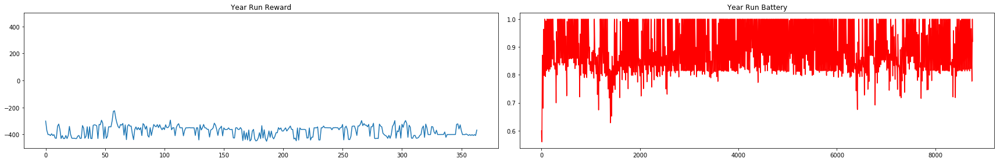


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -406.14150819899453


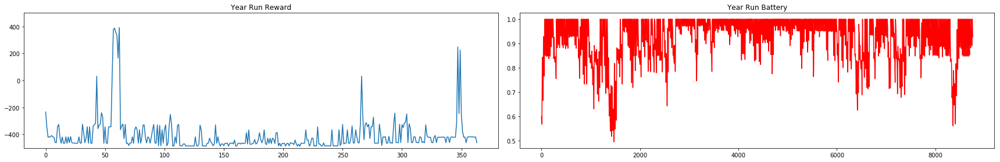


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -336.94342113186553


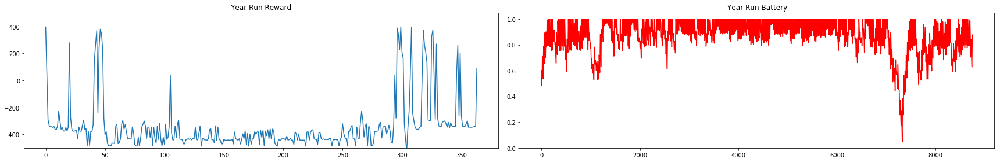


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -274.62669768021306


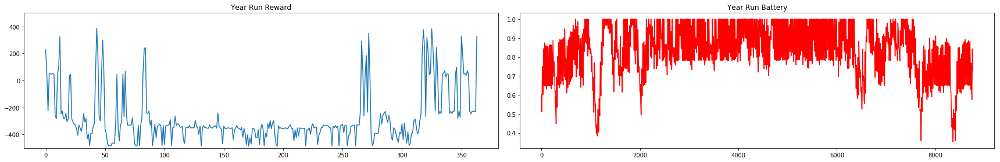


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -335.0372385095574


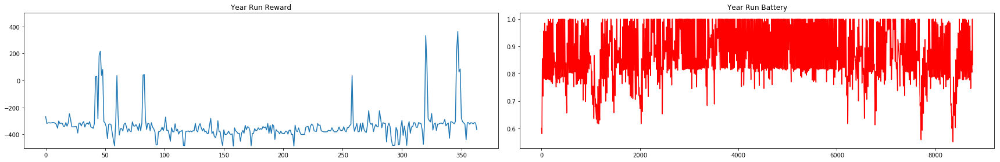


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -325.2401068109011


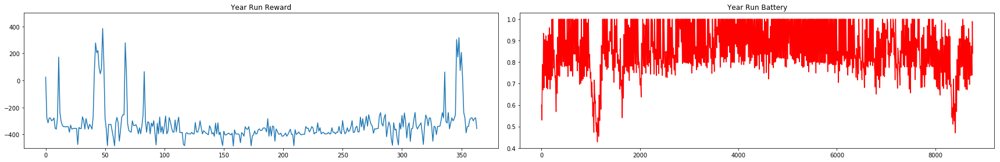


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -327.6827034969728


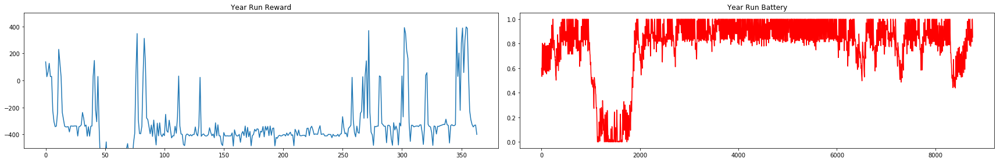


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -373.5097224154746


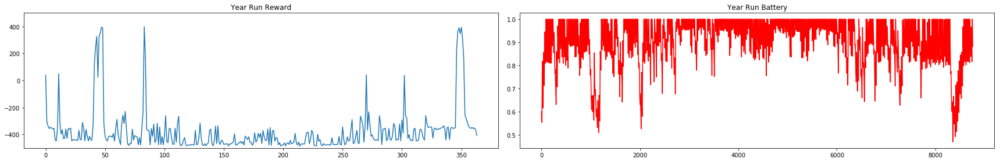


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -269.4272716188718


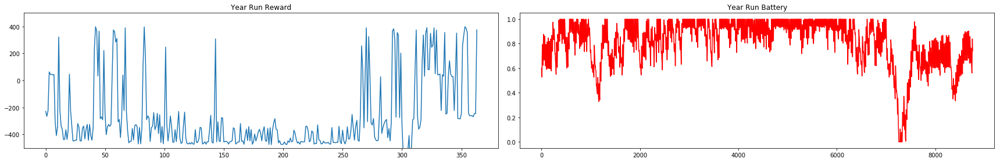


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -287.7398560806954


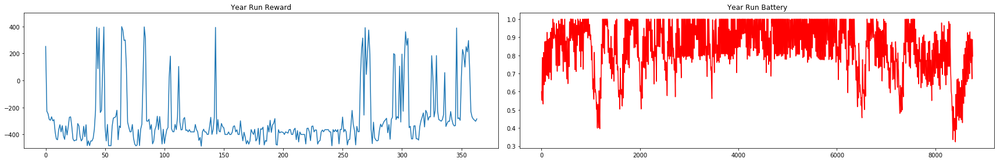


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -251.08247376688254


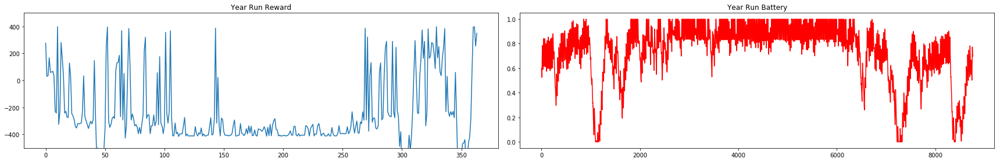


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -365.38573846037696


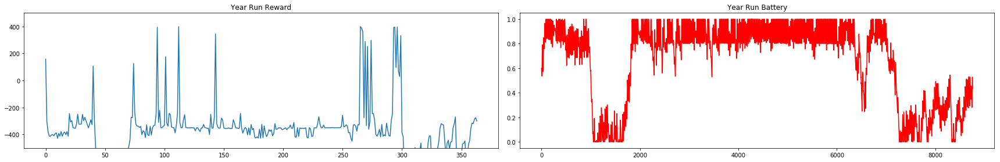


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -324.0379199198209


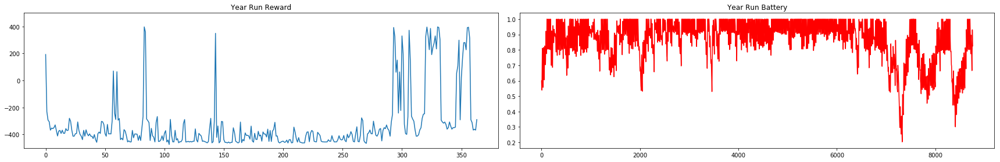


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -261.2183343610512


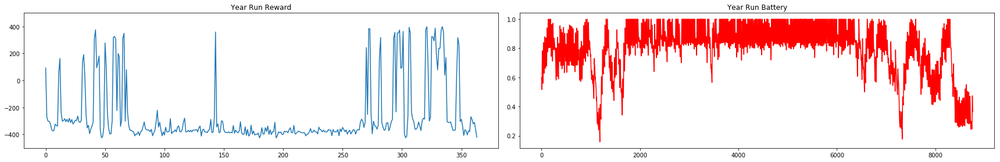


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -292.9663167608608


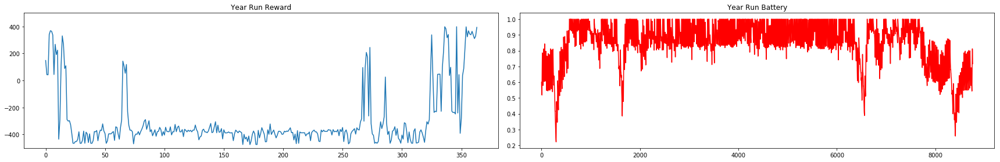


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -221.96461480091006


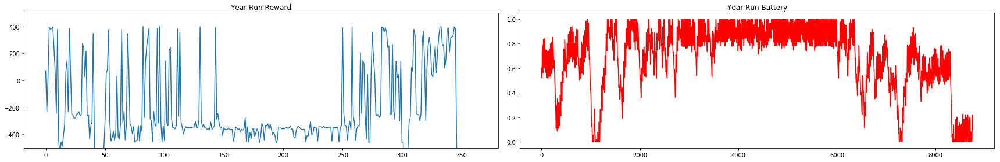


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -413.97366294088846


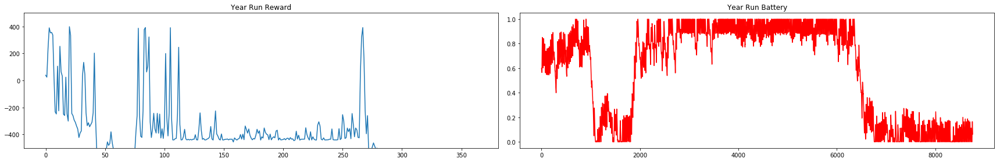


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -247.41515417619635


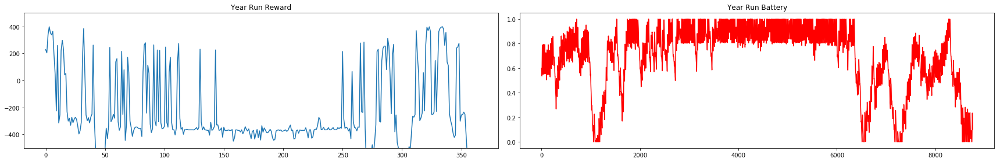


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -393.61826208823186


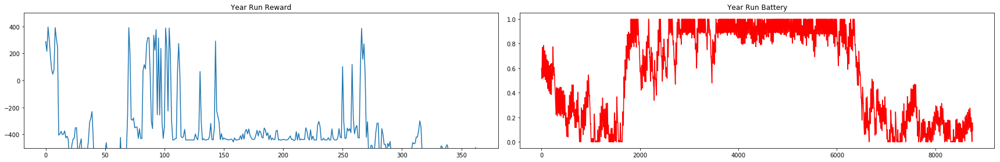


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -280.4680596949548


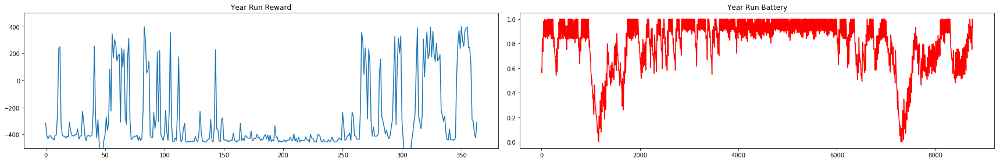


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -315.52444036800824


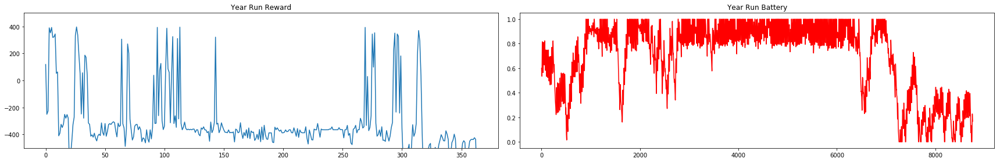


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -319.1140056058914


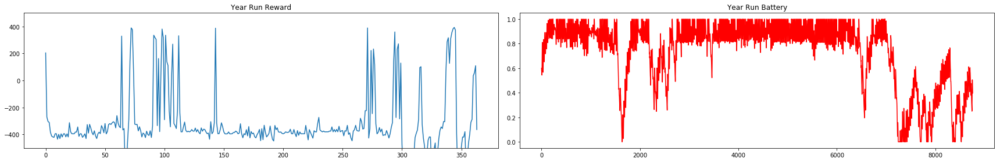


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -387.70613745590276


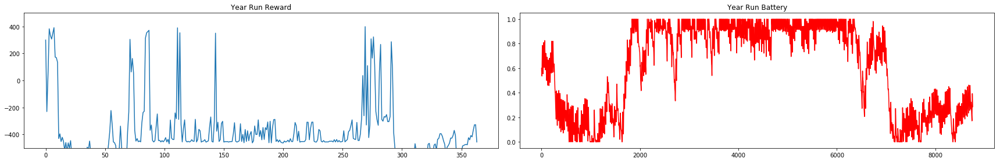


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -271.11292765374964


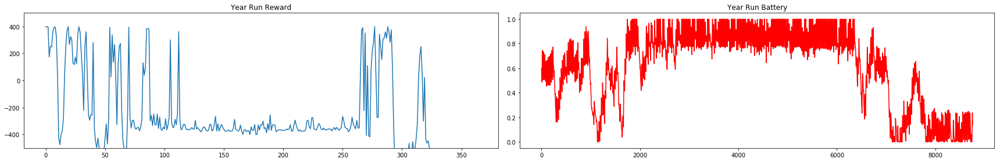


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -169.8556882537629


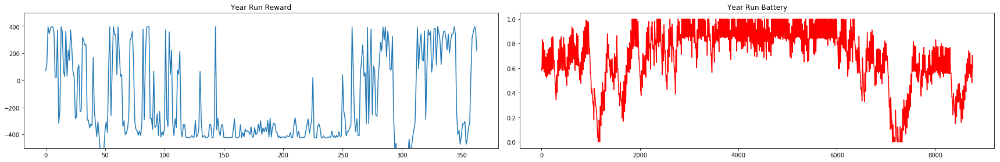


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -238.05311686342858


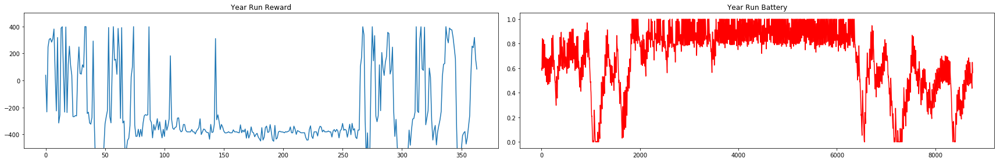


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -328.757257307321


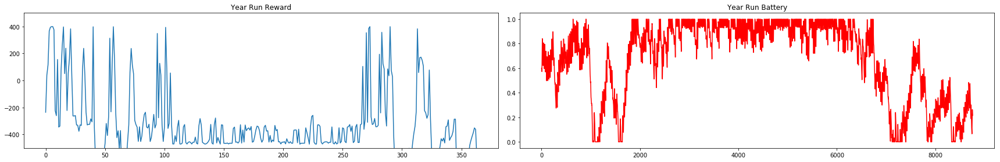


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -288.04925778898775


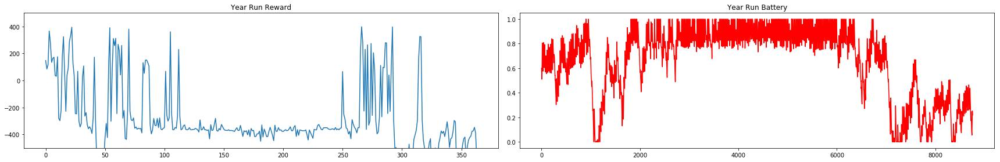


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -335.35665537600096


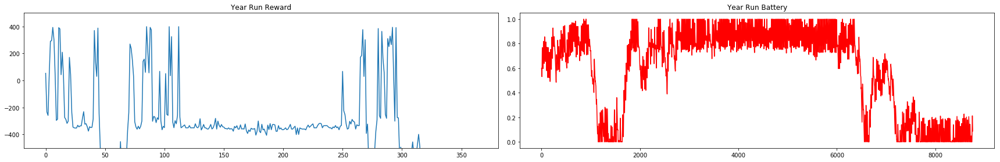


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -380.00489495445544


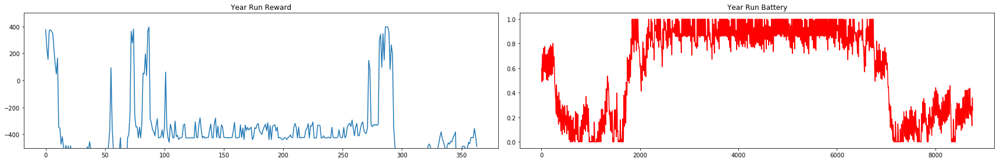


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -367.301120863585


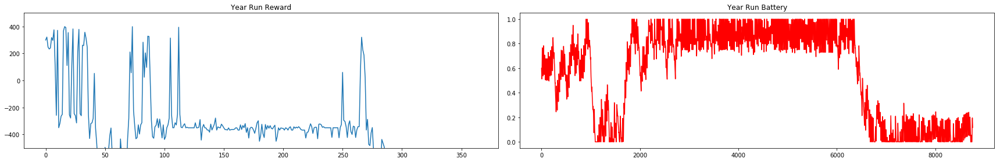


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -411.8687981048984


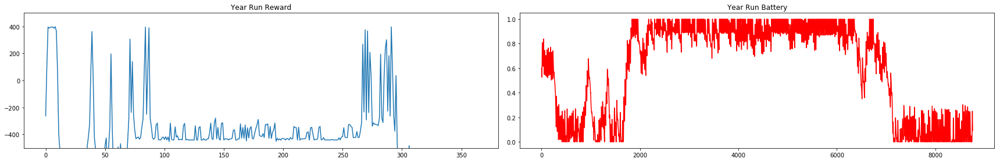


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -278.9191730374936


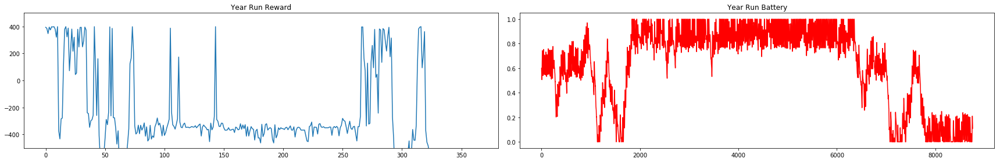


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -299.2657245999082


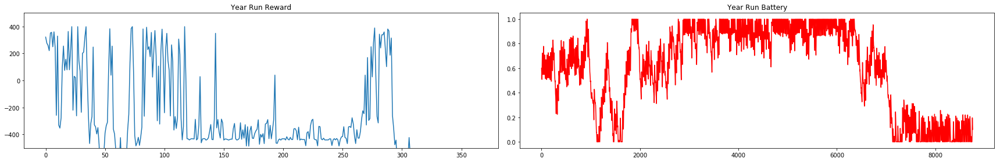


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -430.49195536662506


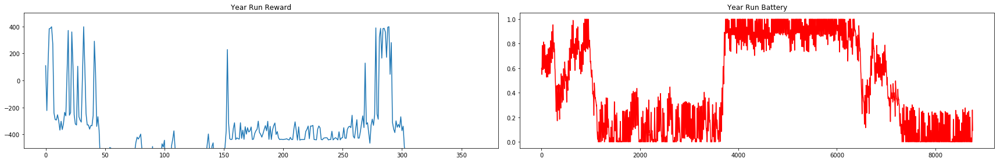


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -393.31163302034616


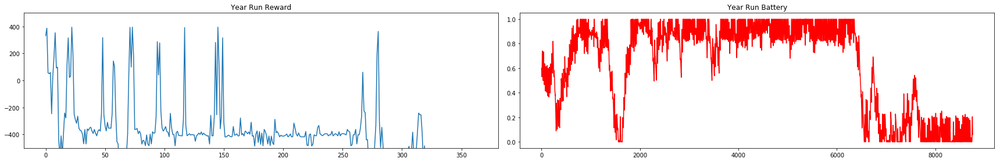


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -279.0816731018726


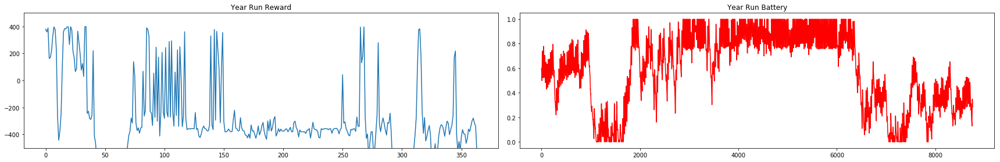


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -208.20502550126668


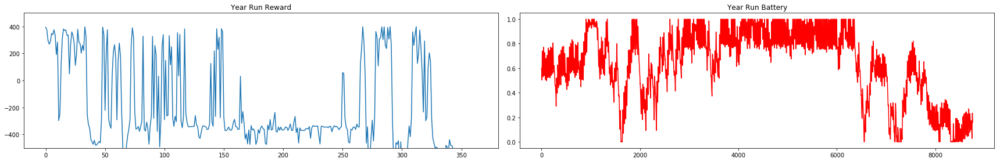


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -302.7896625297758


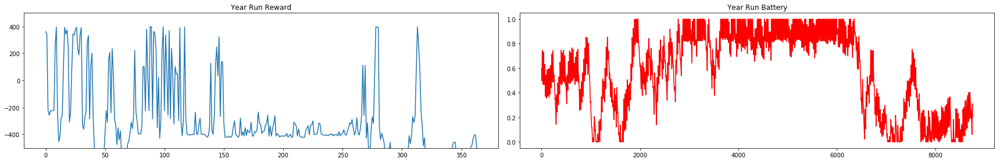


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -219.3743526215698


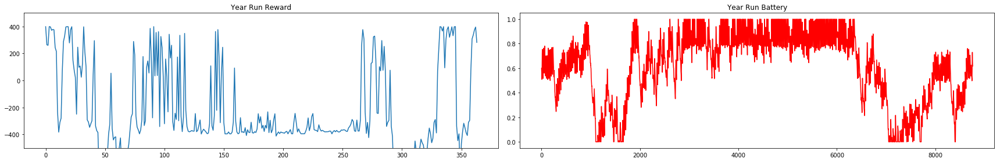


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -301.8487936028334


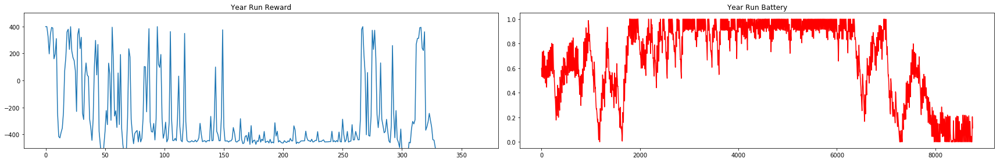


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -301.96557815145064


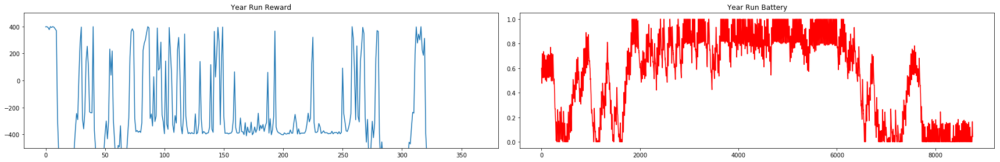


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -246.77770695470423


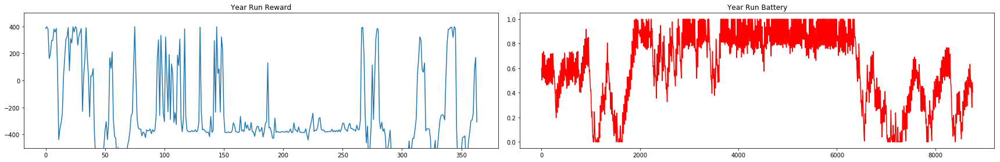


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -337.1986020593944


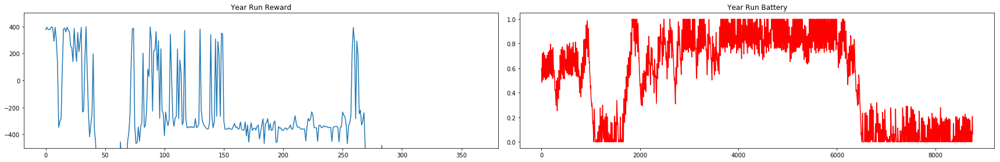


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -419.48057058185174


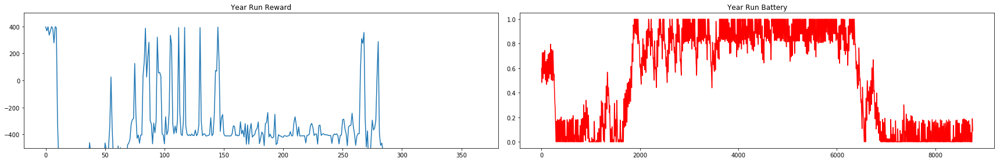


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -412.41629020226316


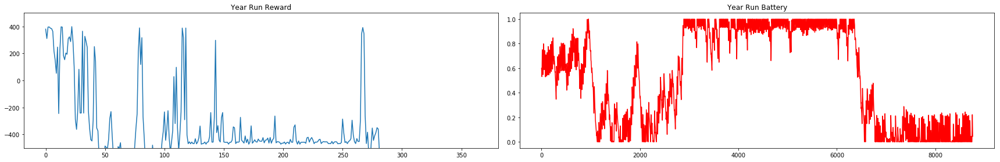


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -245.16045104346514


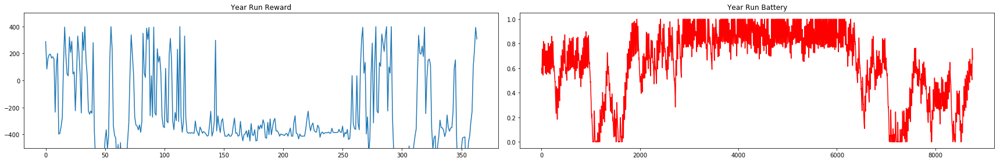


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -377.00032955046083


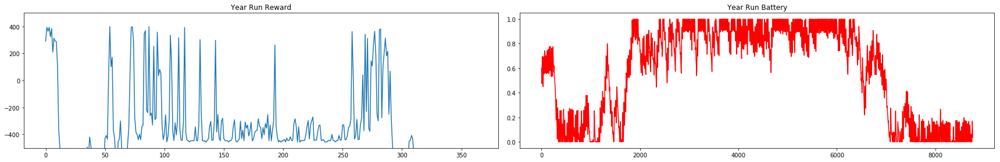


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -319.2363490758312


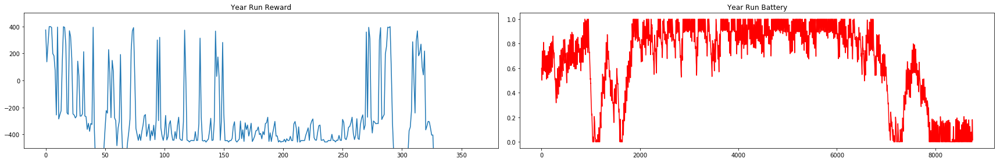


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -431.3720291774342


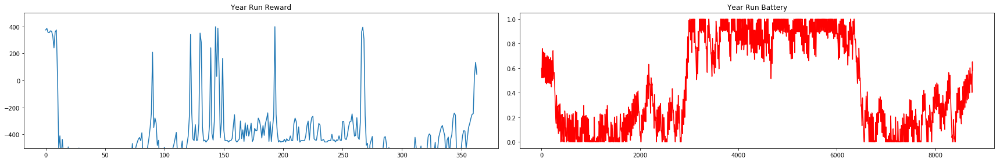


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -344.88477549936215


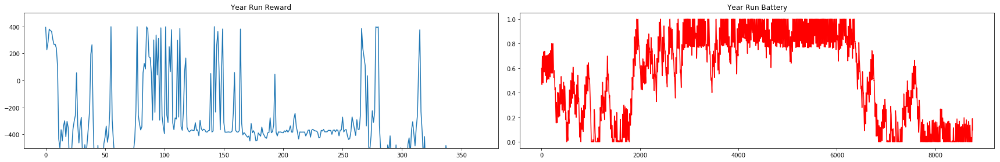


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -299.94241271035884


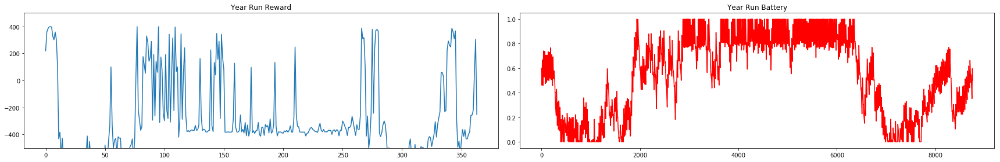


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -344.18228846877025


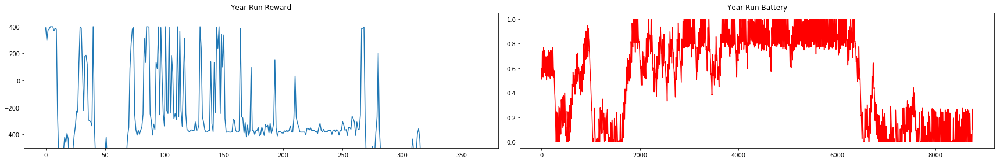


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -273.5645482636779


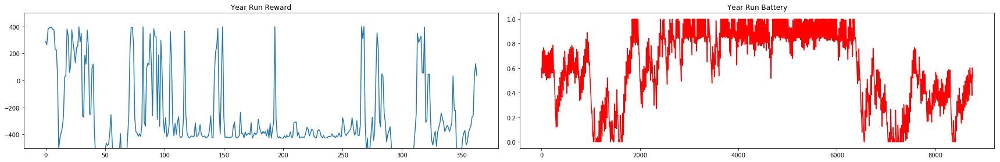


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -223.41895668826248


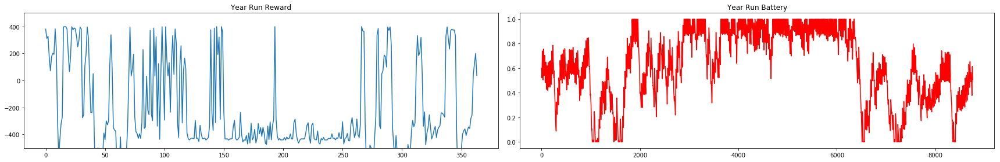


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -323.09438583629355


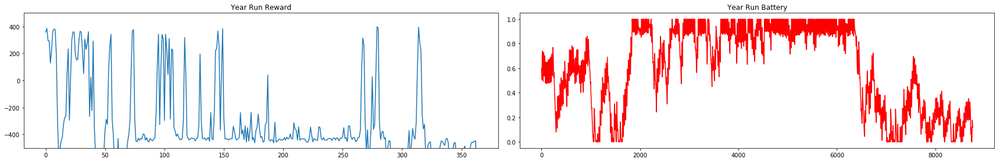


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -333.1090144303888


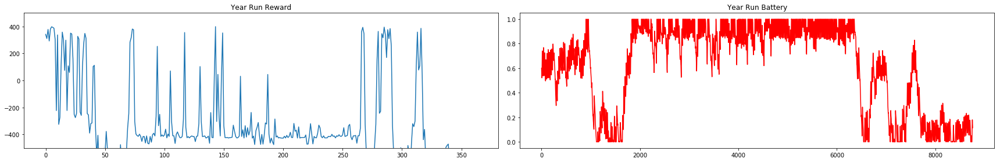


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -224.77588777430995


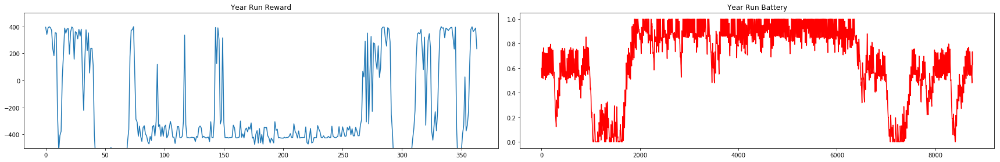


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -275.67885170667466


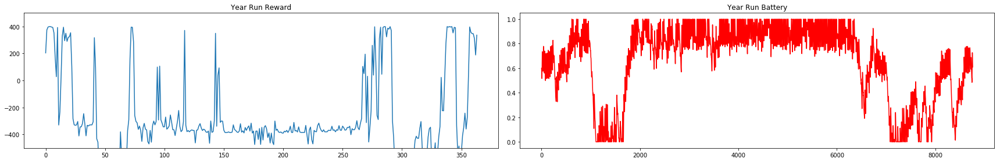


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -411.5354509044452


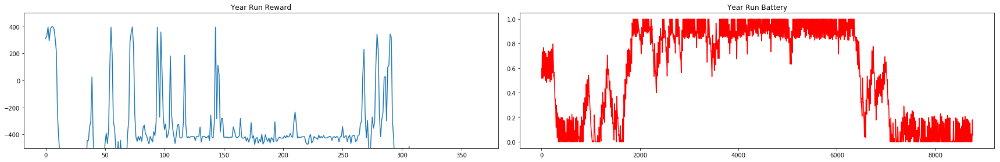


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -345.6397200389946


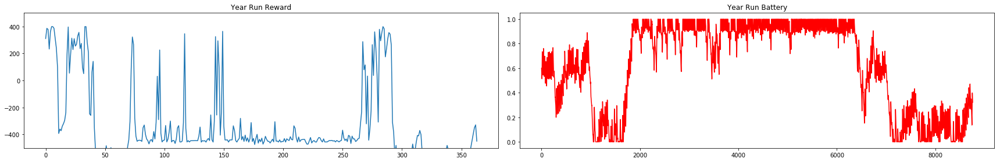


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -317.8718528804162


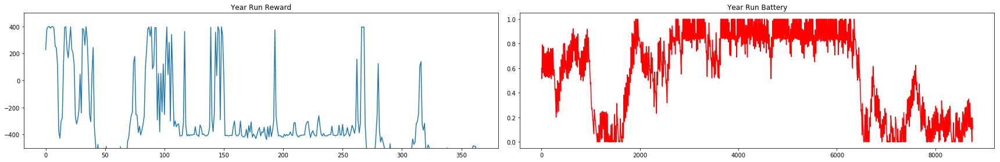


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -290.9594254193071


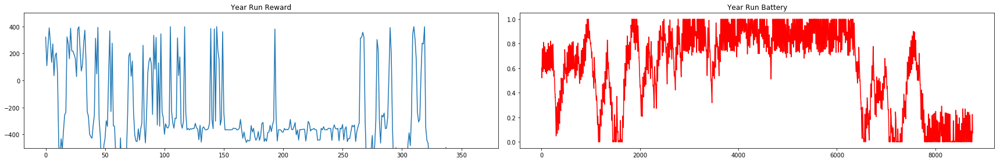


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -277.8090671023955


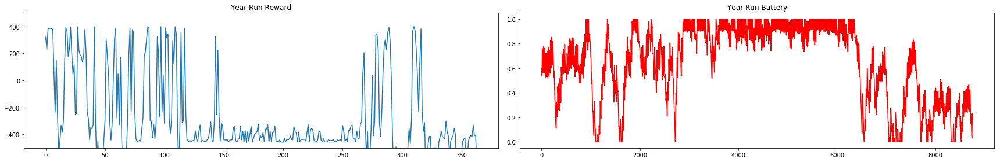


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -242.02904218561704


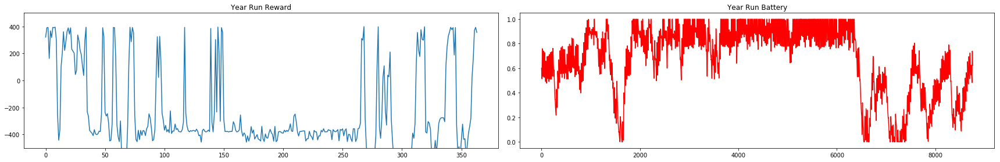


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -339.56332723107954


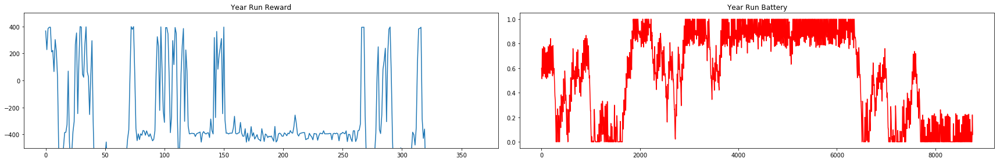


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -439.4427526388487


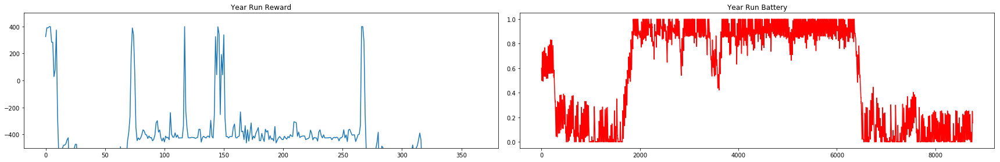


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -334.8796445122661


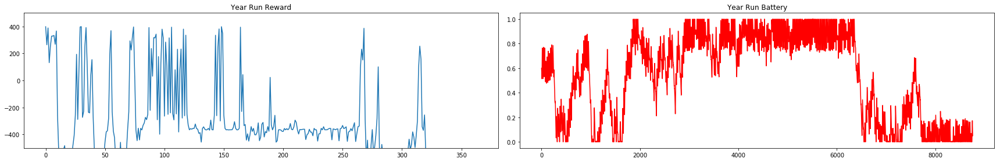


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -262.9999378572233


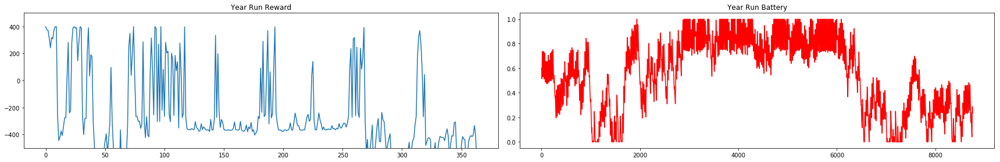


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -253.99204027108303


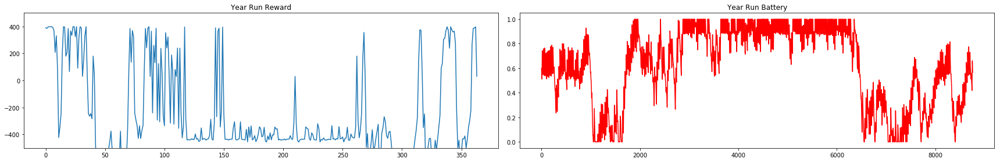


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -352.9860284860189


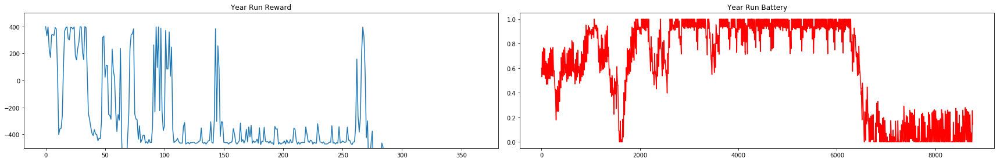


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -365.941130212509


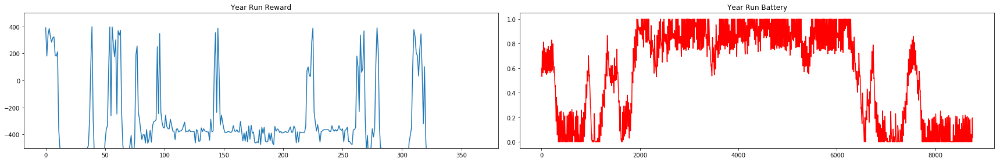


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -253.79453258348636


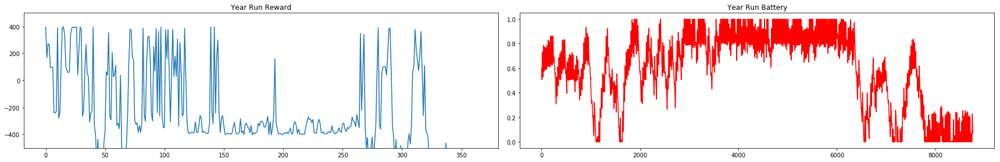


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -161.92229283526416


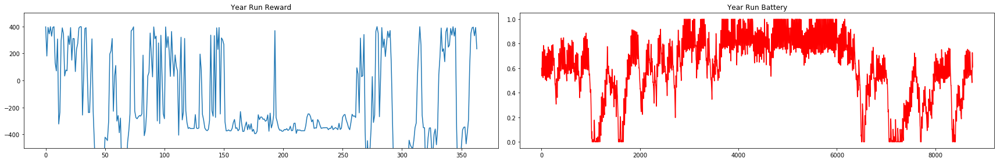


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -280.60109595817886


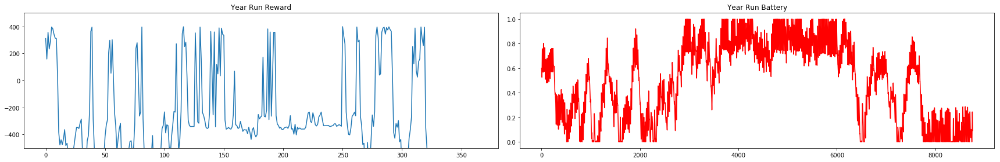


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -155.4058480964725


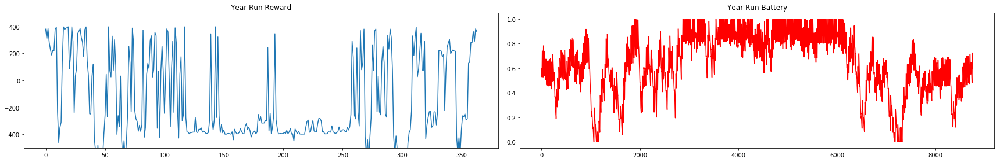


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -199.13251227651142


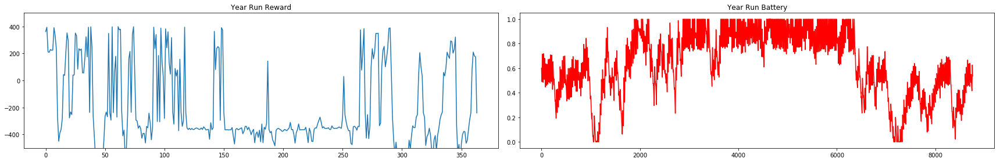


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -233.54353300312434


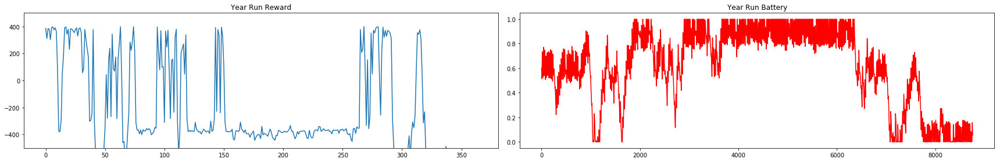


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -323.0644894110182


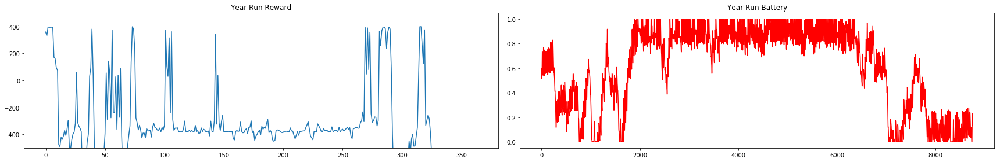


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -229.5842451772348


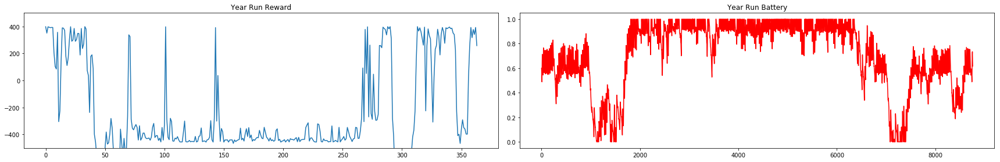


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -314.50333983655815


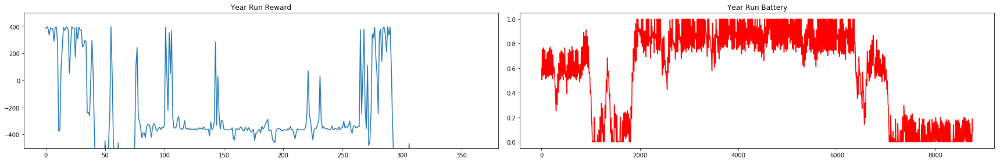


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -369.35356854122506


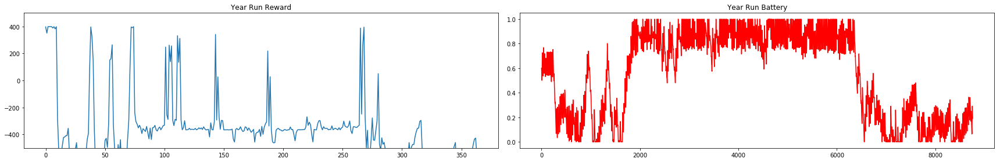


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -365.8693424677123


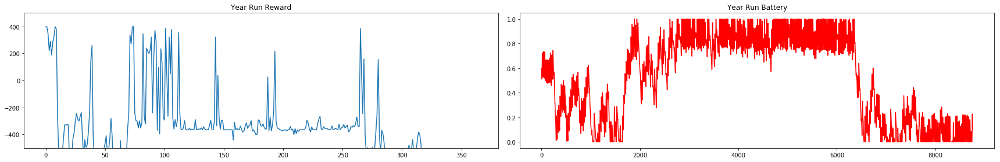


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -208.65491671735396


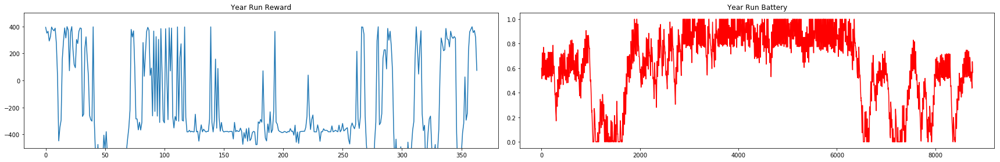


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -408.8795492380346


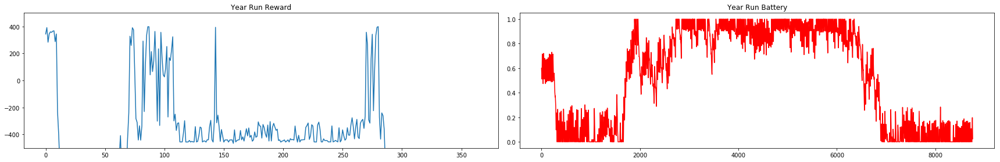


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -378.1880396740217


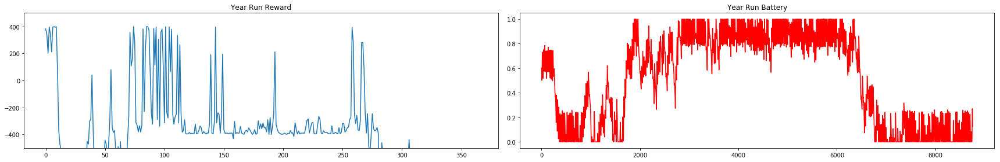


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -347.10476837292305


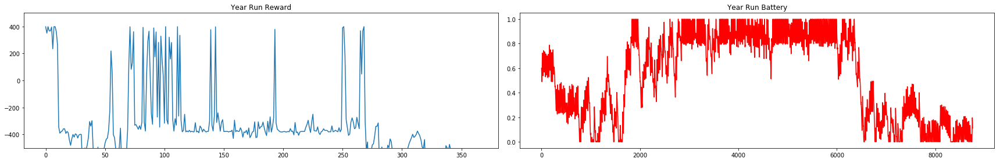


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -372.00532727189204


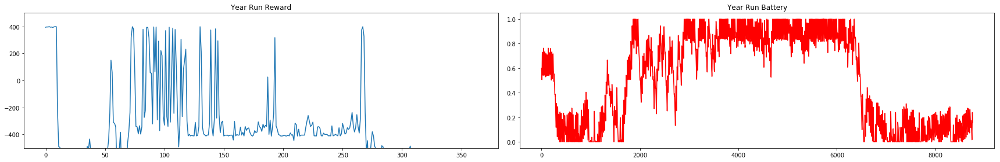


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -389.4905221749035


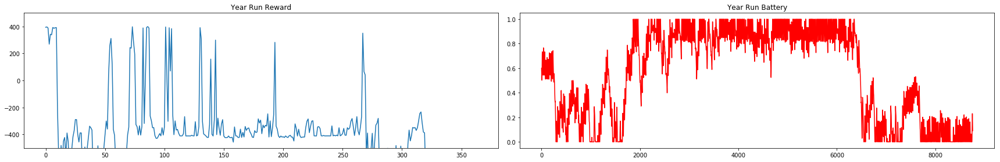


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -304.2001962556211


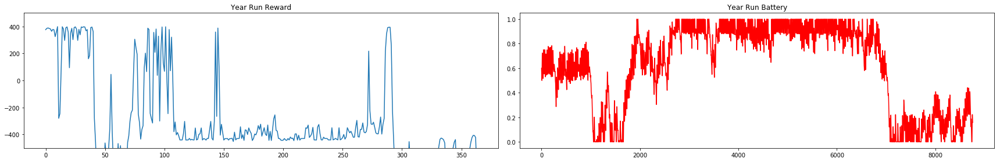


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -279.87328167832334


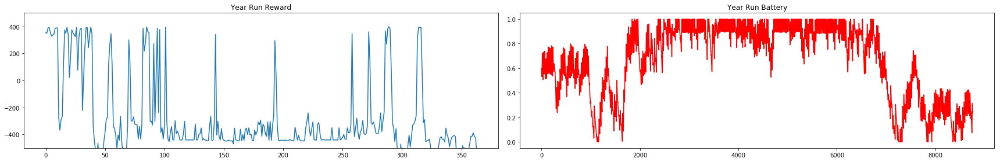


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -385.41217135430435


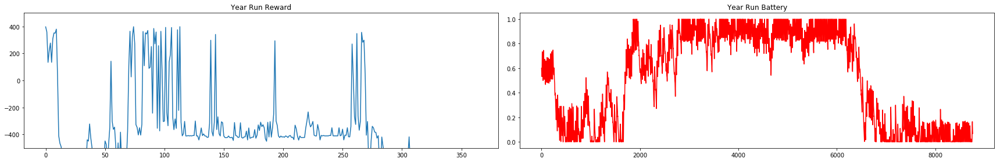


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -297.2544086016791


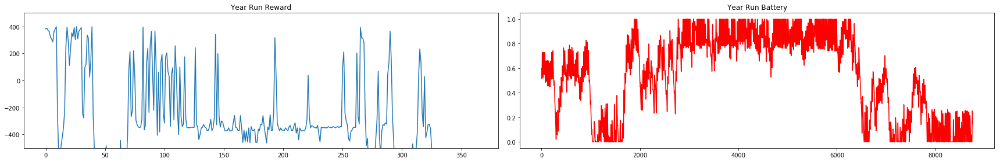


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -238.93432304839476


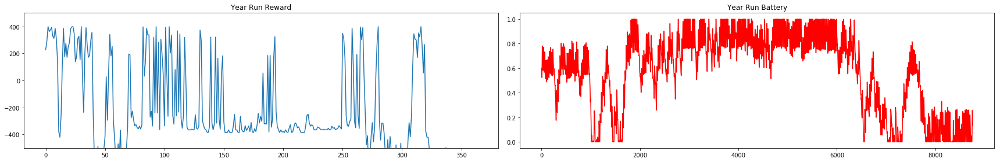


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -395.22104325895816


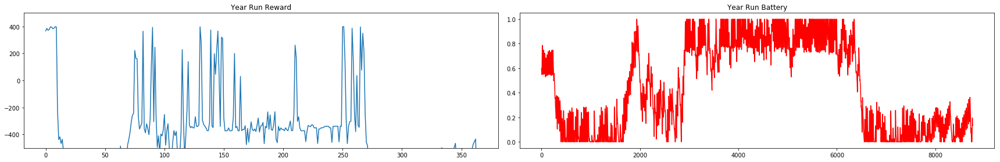


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -357.3196950104042


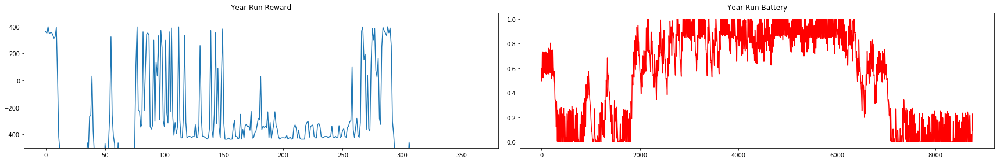


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -296.36742052996766


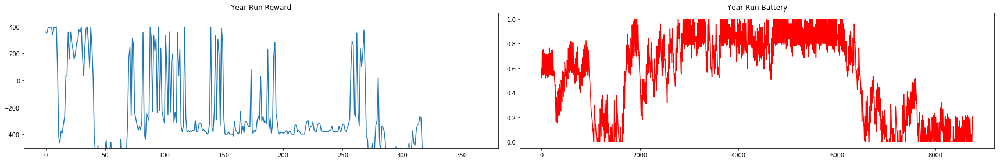


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -383.4499908054587


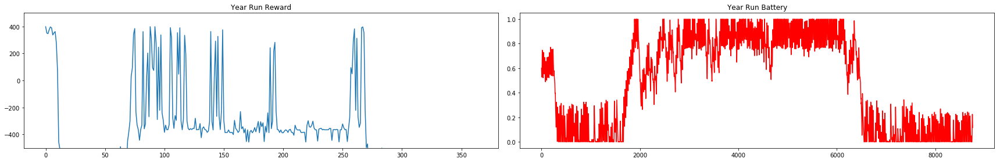


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -263.9673994001849


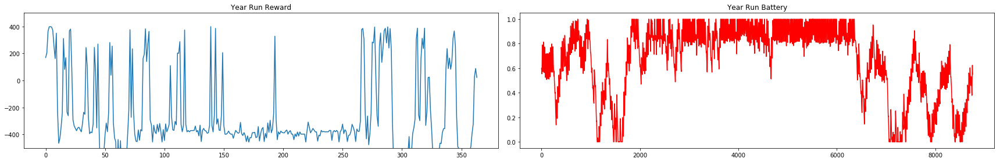


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -333.64838183537205


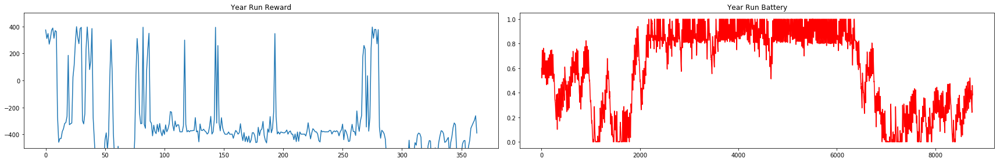


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -208.75826600733095


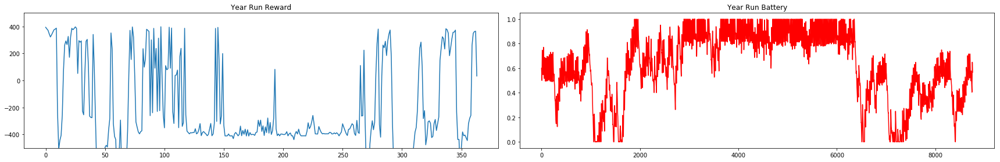


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -219.85762631905132


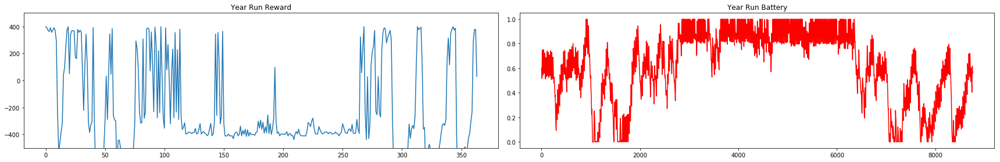


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -305.83358147221054


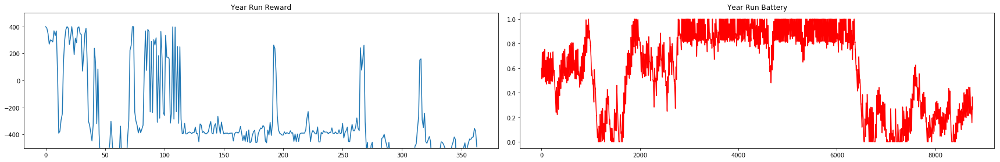


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -322.0126947501044


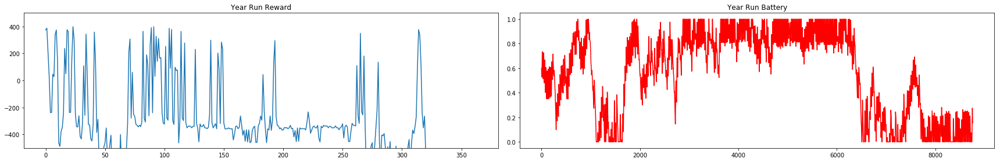


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -280.9822263916915


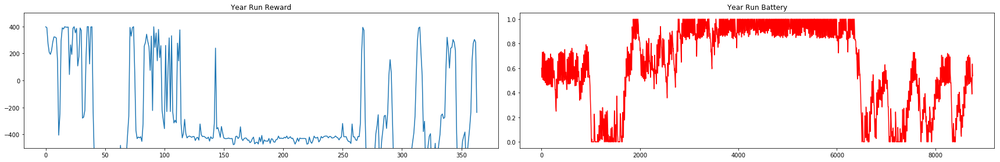


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -313.87185070245613


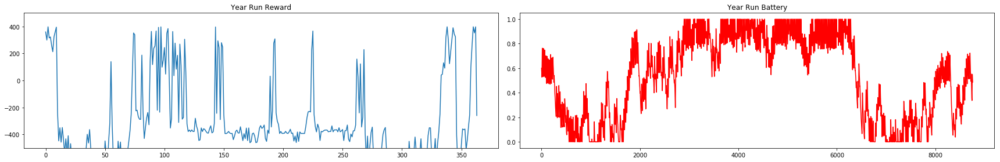


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -337.73013419980896


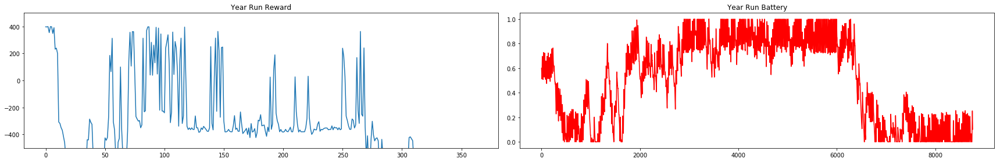


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -224.6000488580002


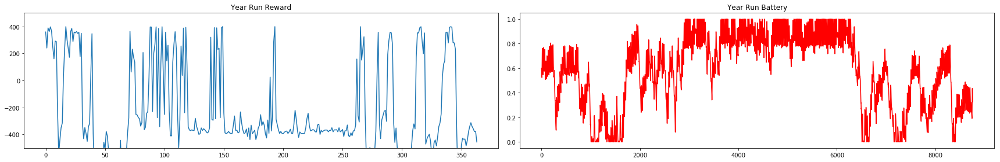


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -280.5842195237136


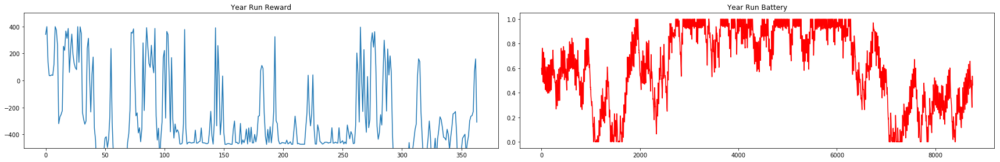


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -387.967310809886


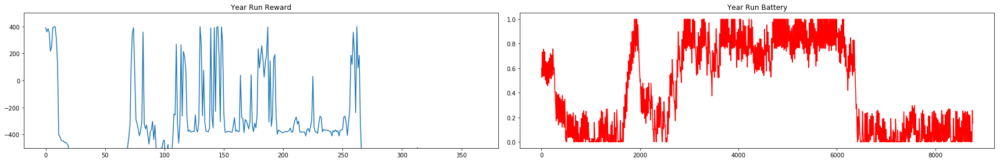


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -221.5161410743121


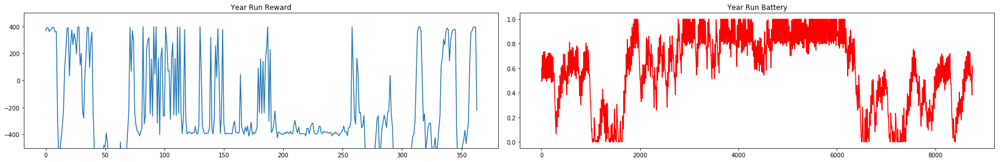


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -358.25850275482804


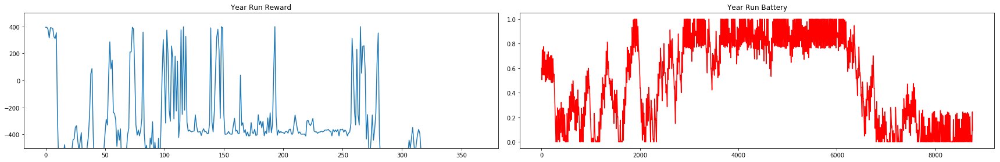


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -267.44832396297585


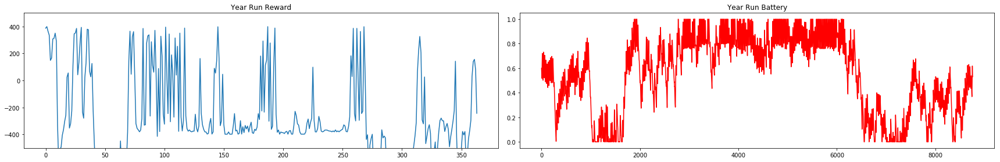


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -314.16180663610936


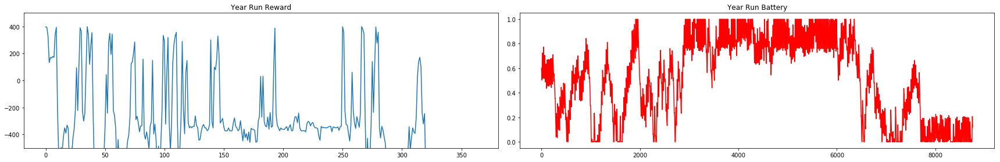


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -180.87179031146133


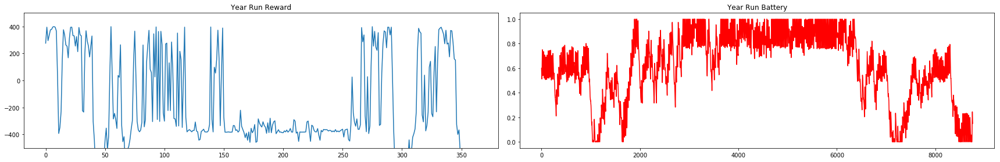


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -223.9655504064638


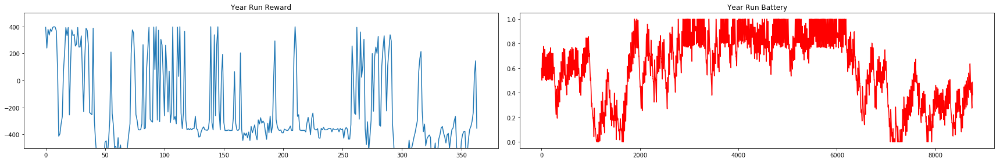


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -170.56215963633258


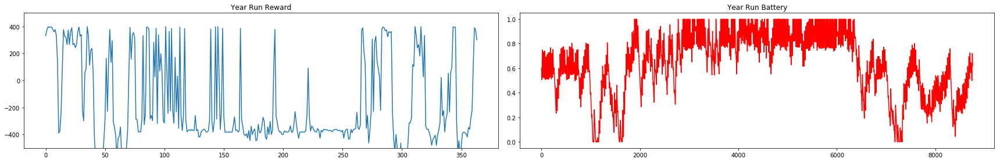


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -311.98629996921767


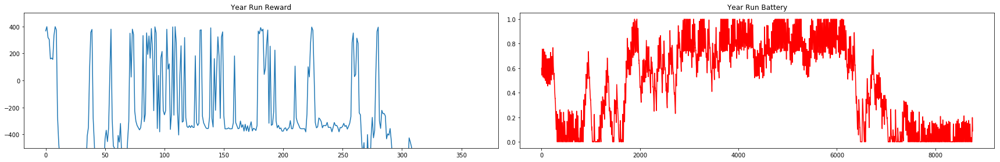


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -354.86085290320983


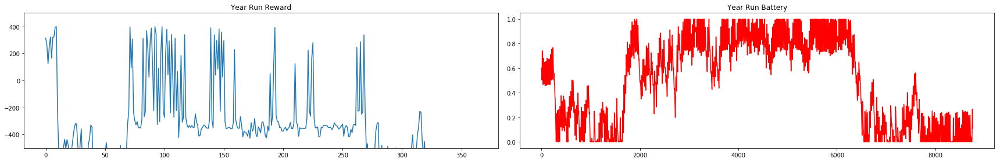


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -349.5786257252654


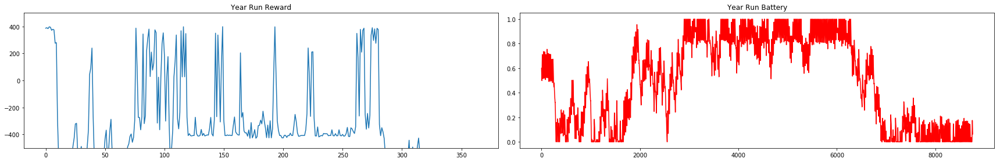


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -215.64909551048265


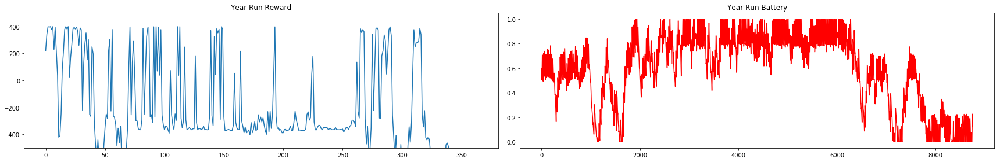


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -267.99936018900354


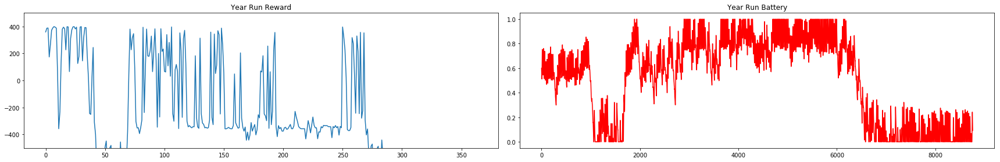


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -350.5853618067364


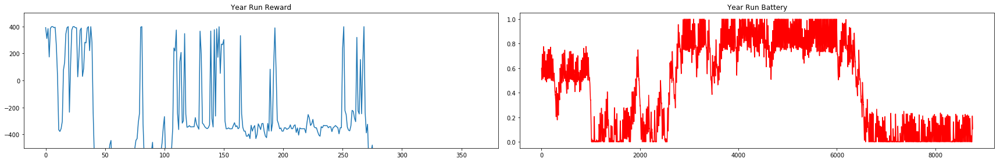


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -368.2840585094057


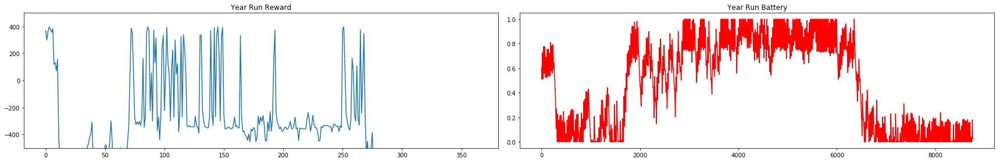


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -161.05396678062007


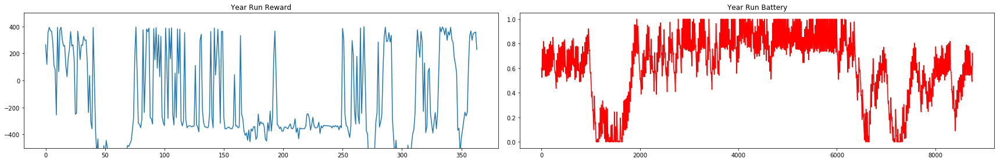


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -174.71245890263657


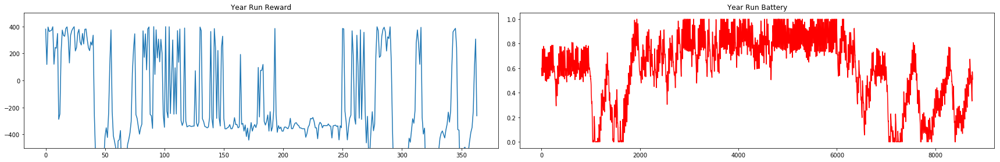


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -228.5291387268391


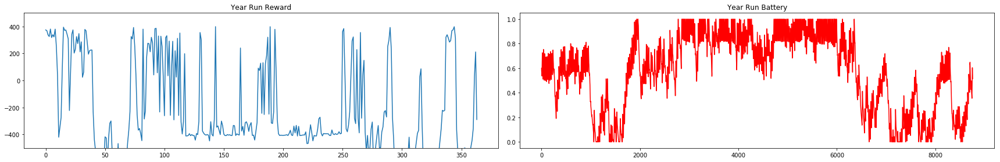


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -293.1360082484047


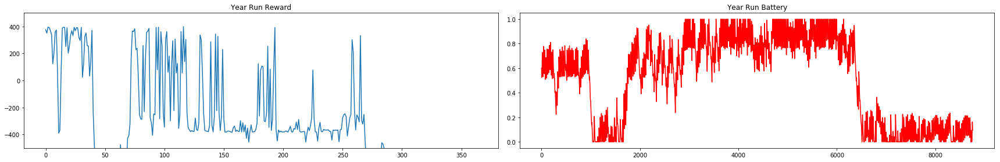


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -319.0805171802018


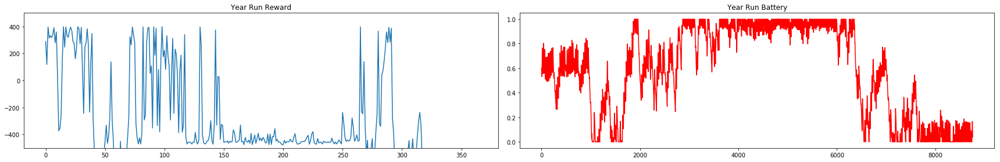


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -350.41651980851134


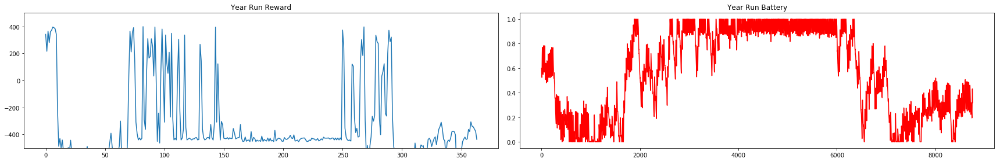


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -259.64533586385863


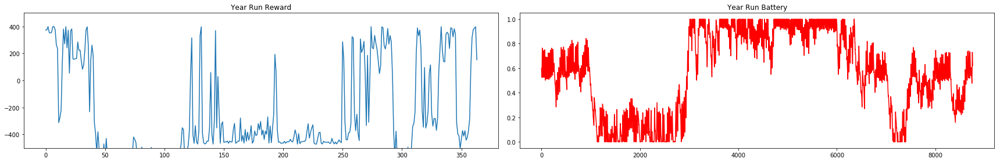


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -216.07045677963058


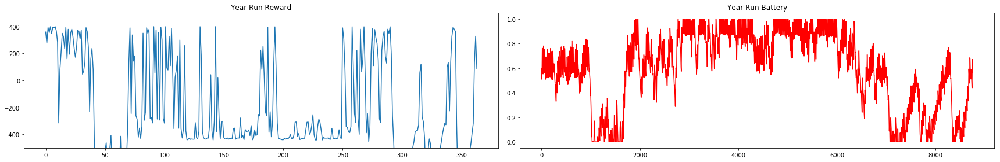


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -191.46550897752547


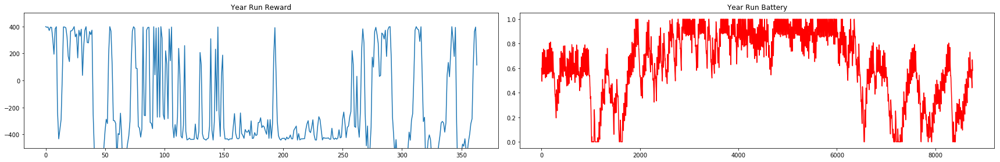


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -261.954155366507


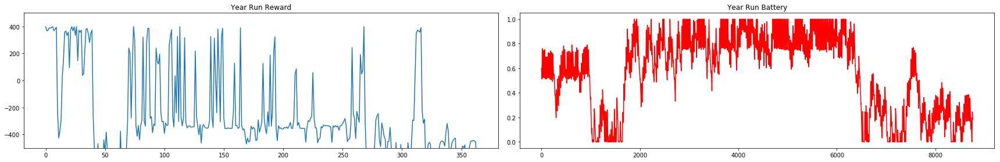


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -253.7979590047355


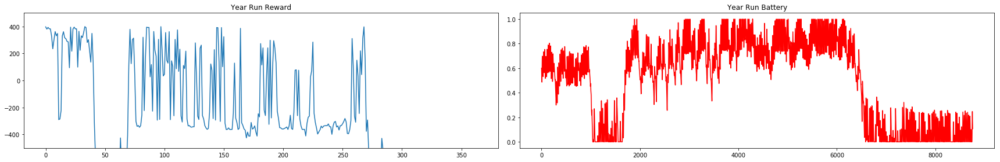


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -338.12999884621087


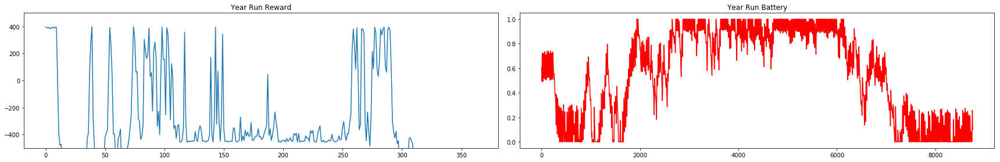


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -205.02377768410184


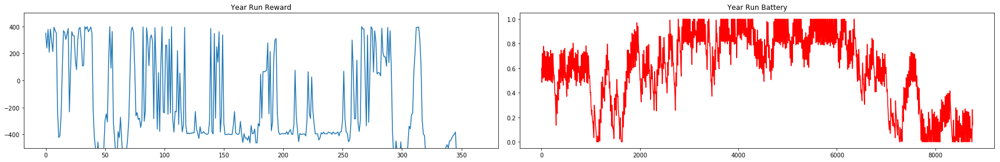


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -314.9638815039768


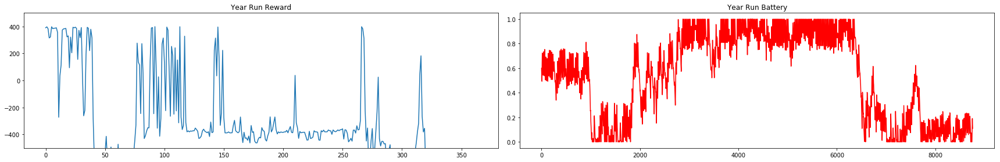


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -103.59739994951869


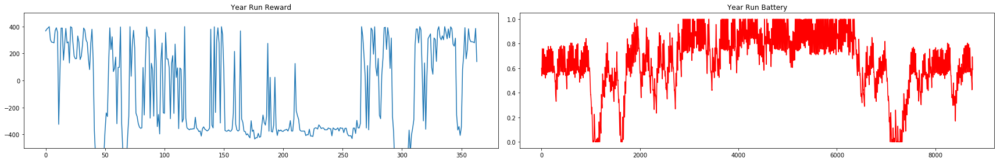


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -164.77835631750227


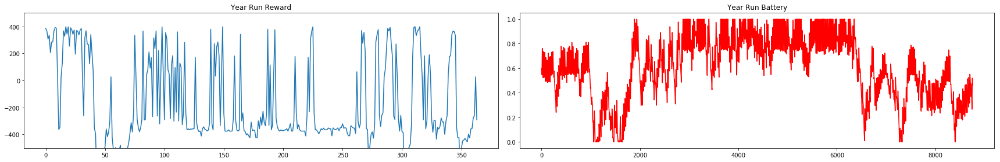


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -293.8297124660868


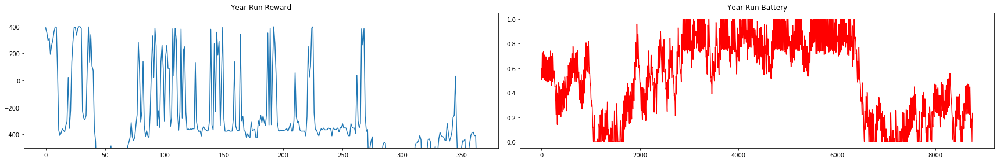


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -220.66109001970415


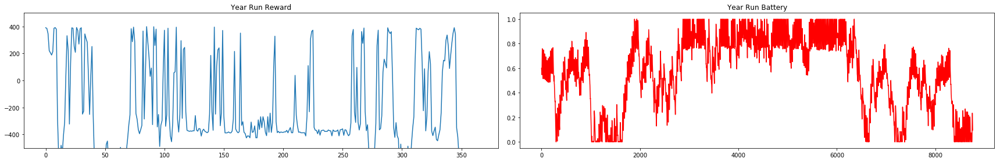


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -232.96986993030168


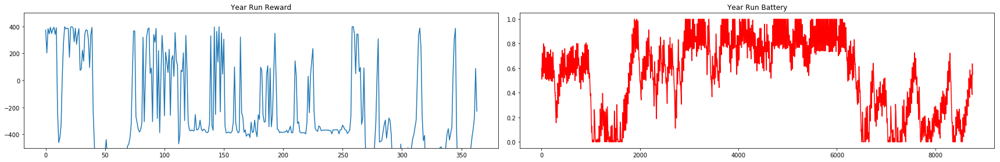


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -372.9098925103688


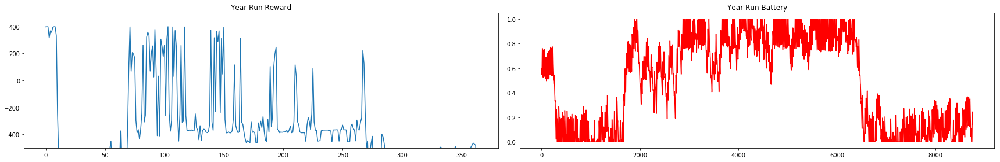


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -274.2334481959149


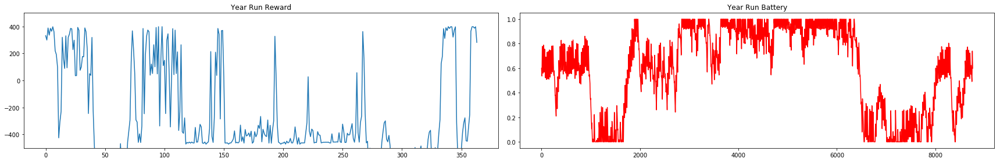


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -294.3320053768102


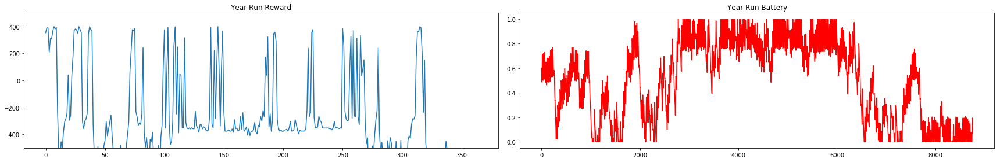


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -160.80811661733284


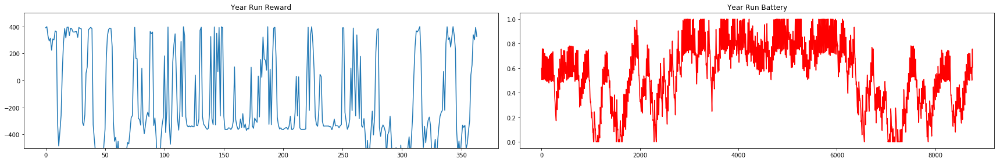


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -179.41241285994198


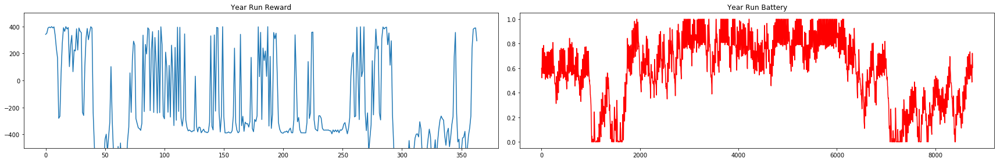


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -172.07860890470337


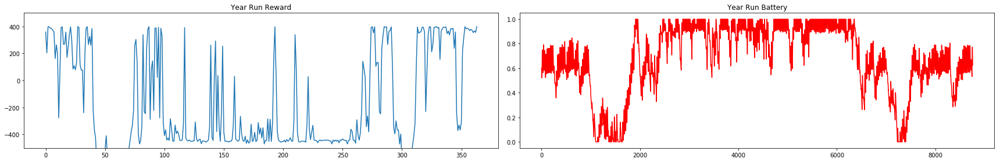


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -142.13183133816597


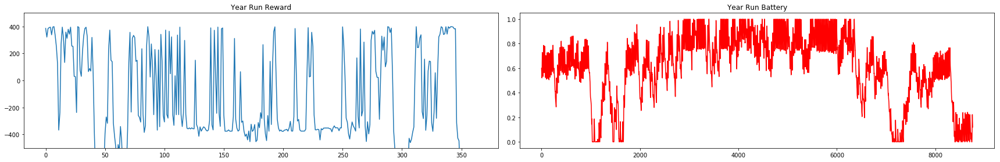


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -389.516946241386


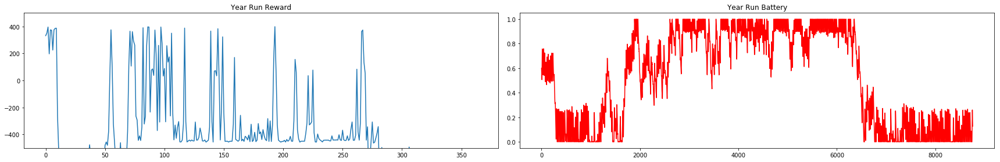


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -159.22046708599672


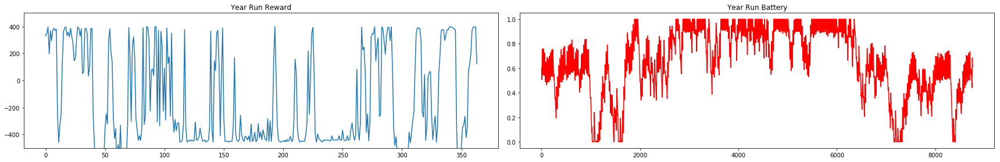


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -203.34844662426246


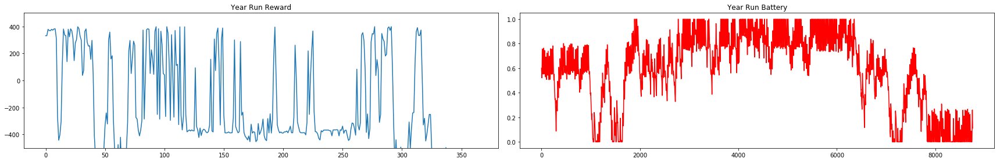


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -225.4700689460725


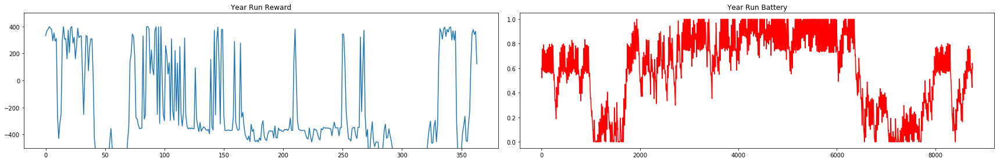


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -226.65805082051423


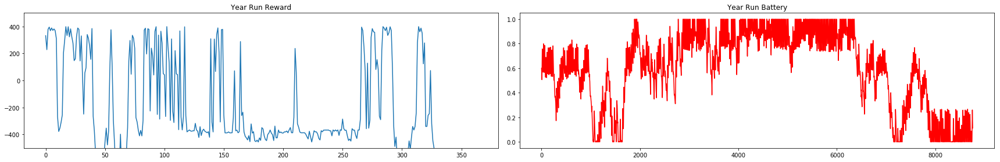


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -112.60097462085895


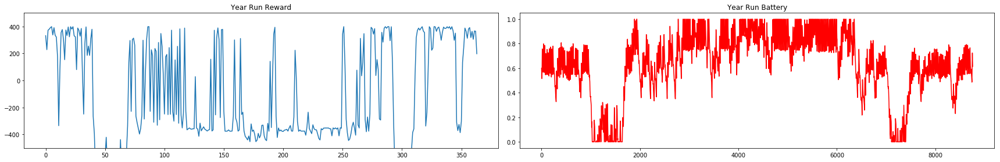


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -126.36562157957079


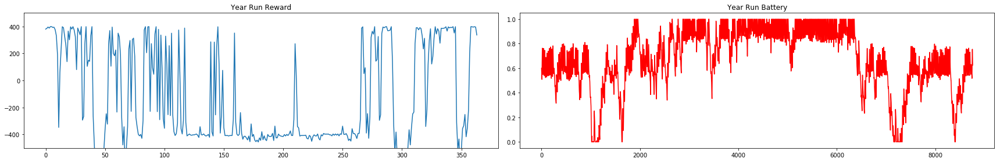


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -285.65814765632416


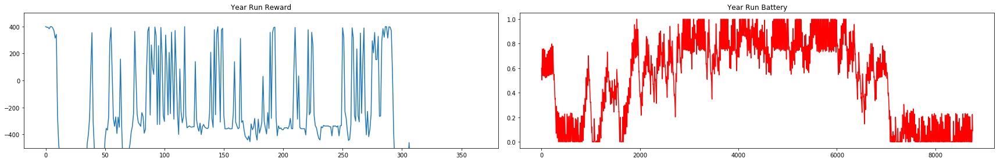


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -266.67379505903415


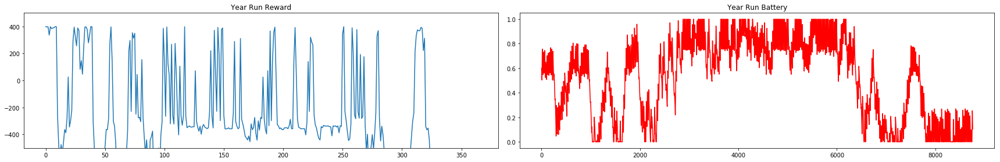


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -183.54803129668025


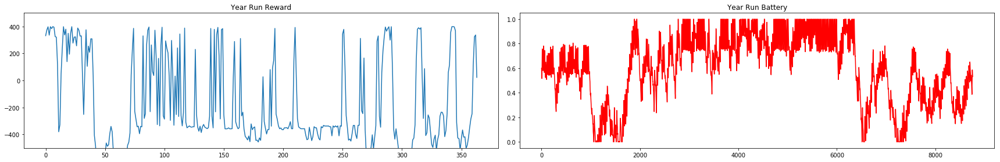


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -243.767410750645


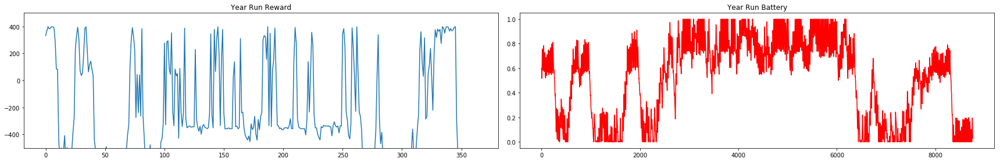


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -205.9588531505704


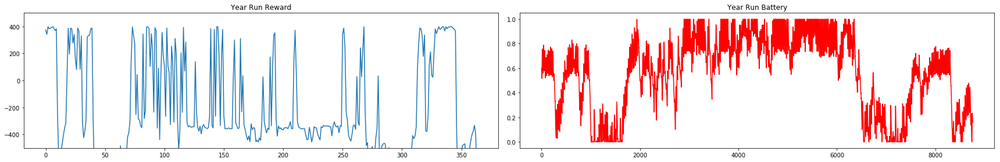


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -352.4632591579339


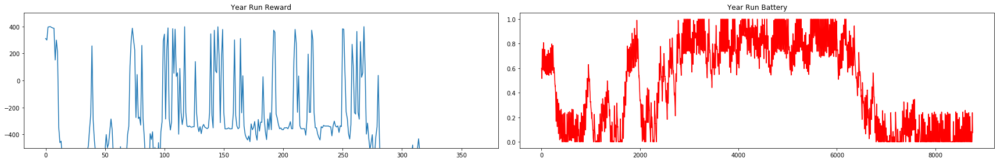


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -253.75059688561888


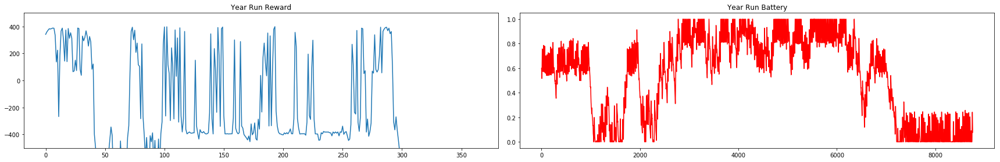


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -144.13218156559057


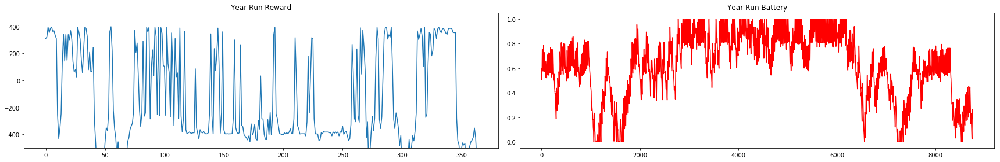


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -123.96195723421495


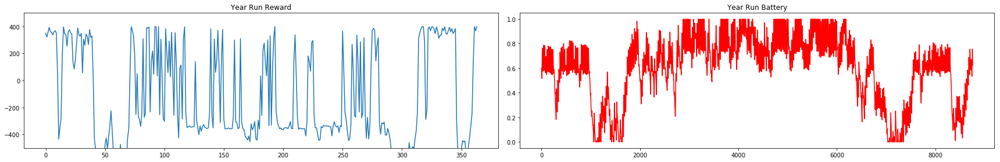


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -306.4209354537835


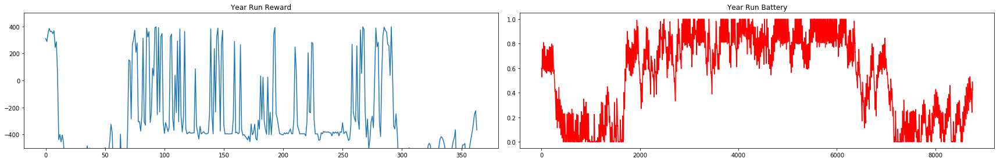


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -127.58434555680475


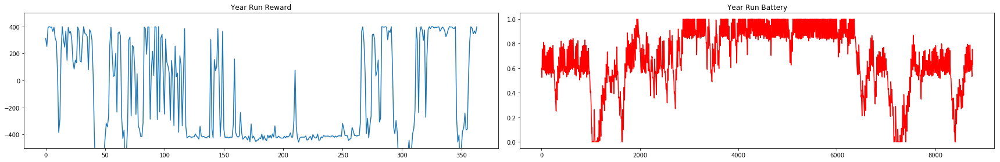


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -182.28805321037865


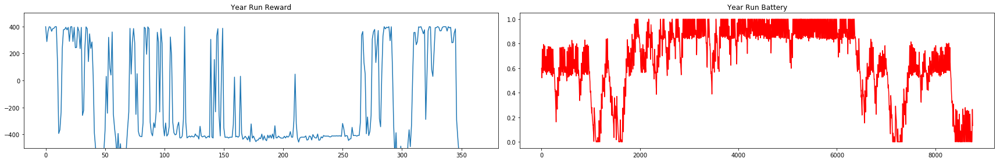


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -223.09230088972342


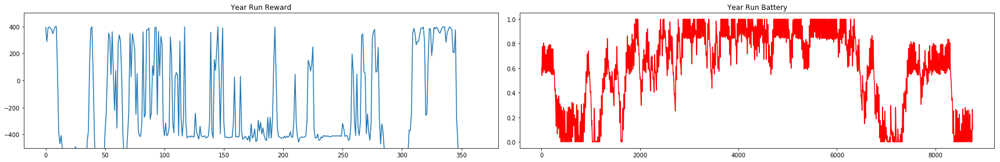


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -252.37834612708508


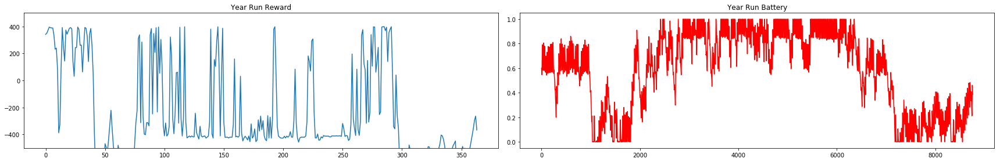


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -159.86872642570546


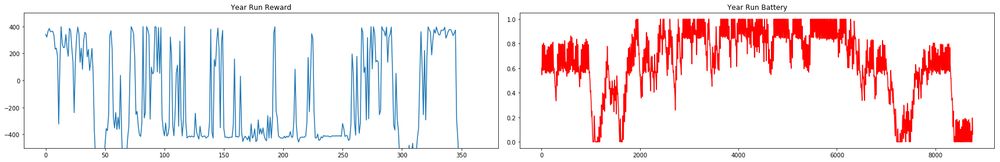


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -251.21020216211164


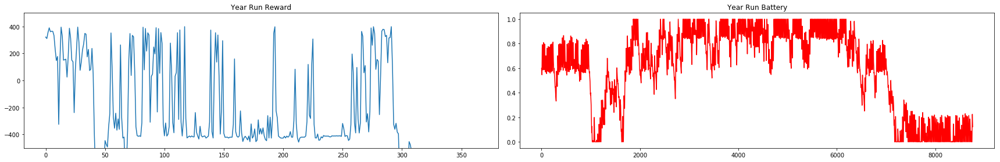


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -105.10610110619265


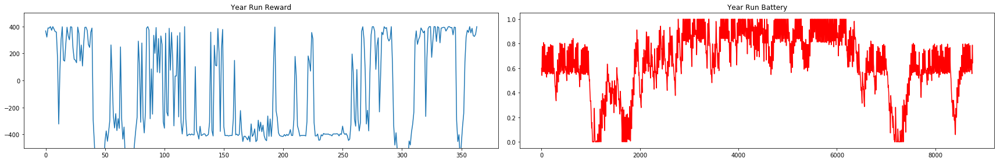


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -144.83518452667553


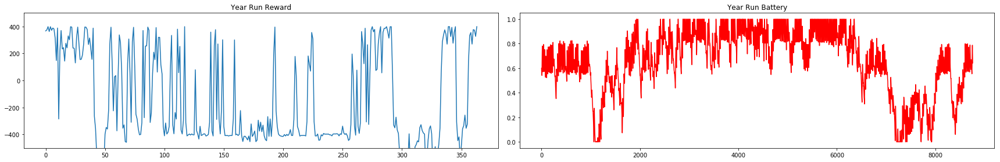


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -76.20741756537473


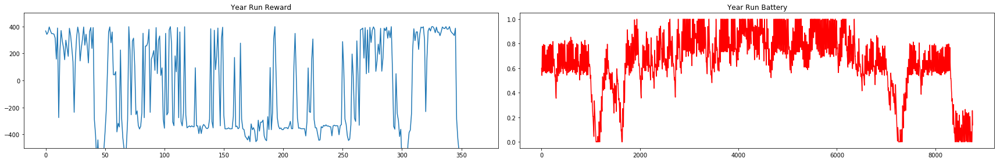


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -63.00687837500256


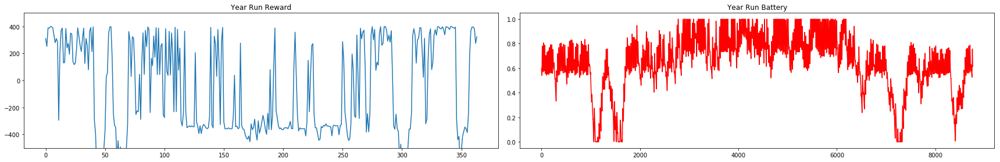


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -100.37617039035523


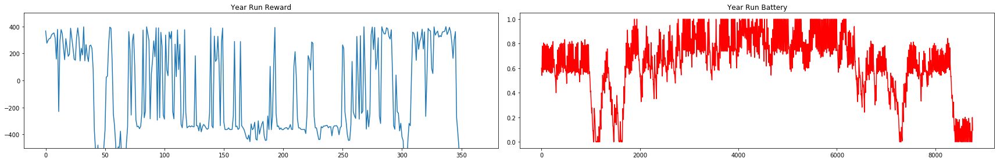


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -201.12211100193943


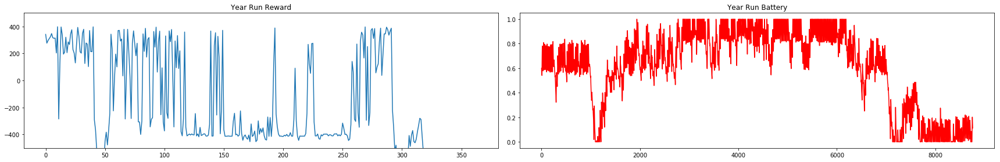


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -109.38145153264186


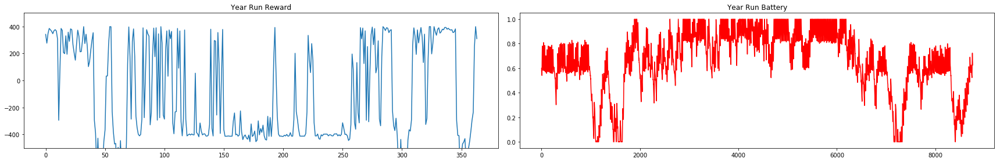


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -166.22850730524584


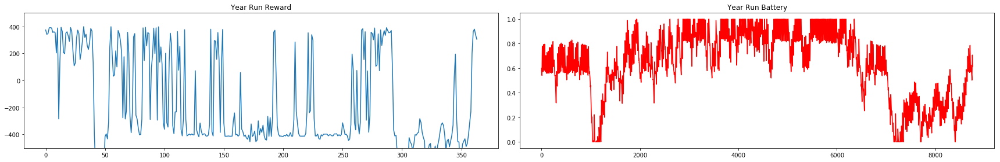


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -114.3731331760701


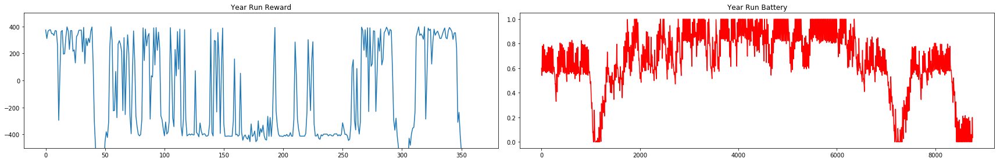


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -190.25282674093637


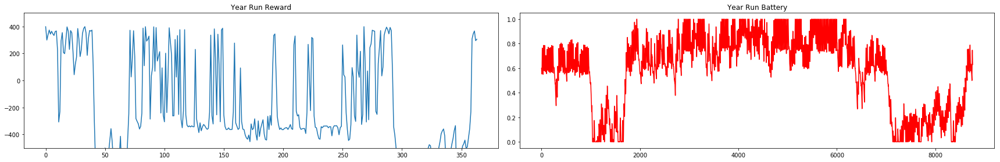


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -110.06329823484403


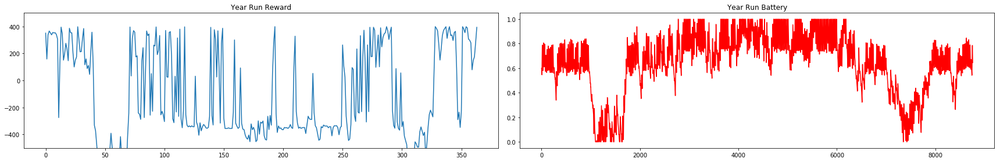


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -37.361971415514176


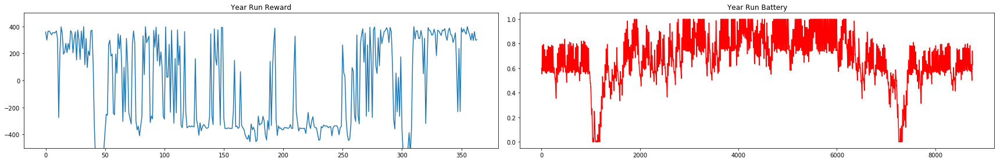


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -31.832442633818143


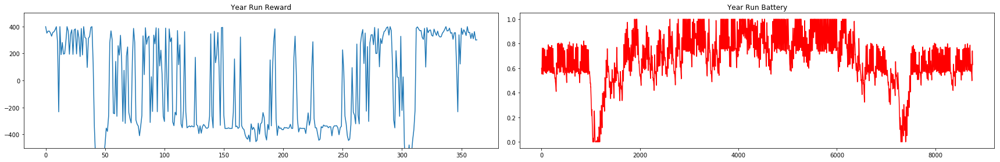


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -79.8656823263268


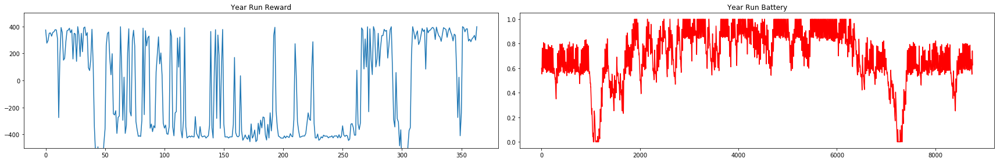


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -122.59080538075648


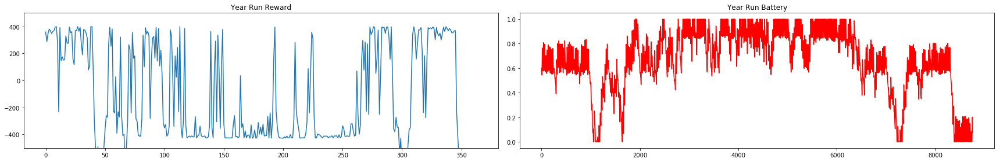


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -81.4714344550351


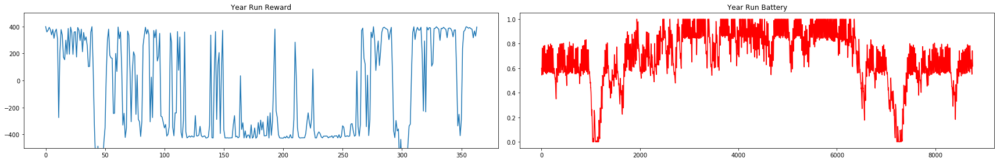


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -101.86226315733931


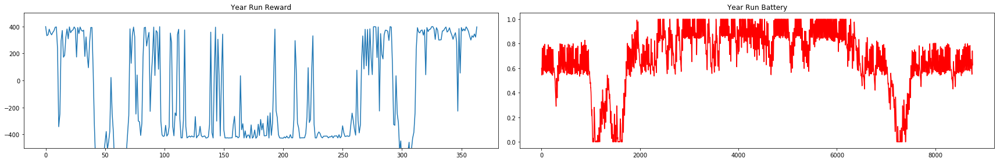


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -63.52901692395984


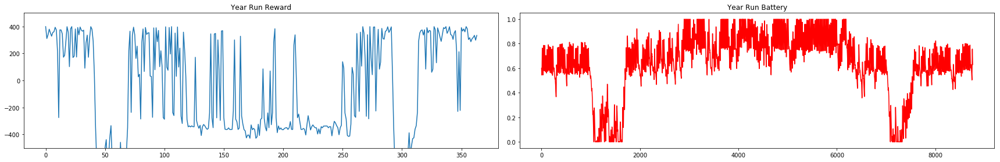


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -102.23137281724992


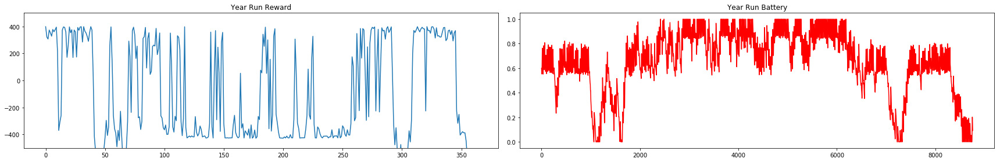


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -44.95457584872206


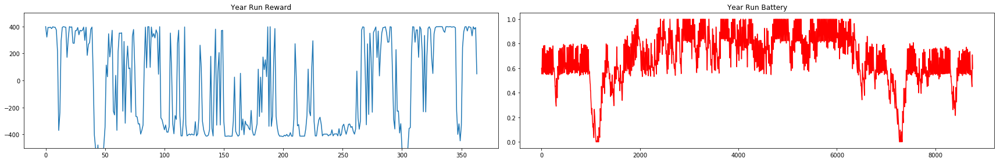


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -50.18740486392619


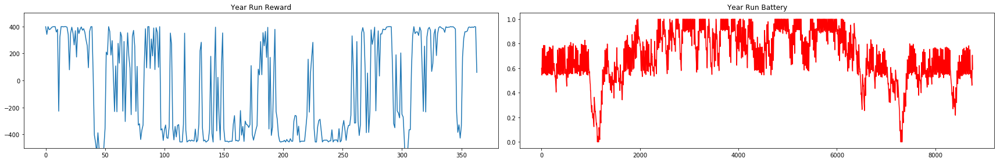


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -187.79686528748064


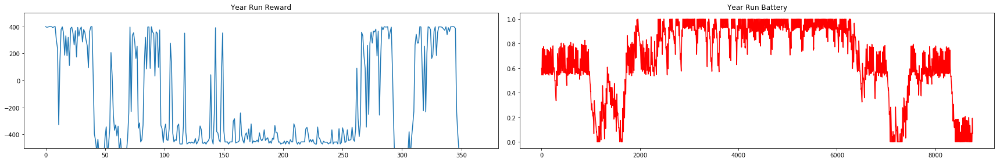


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -118.00693710022544


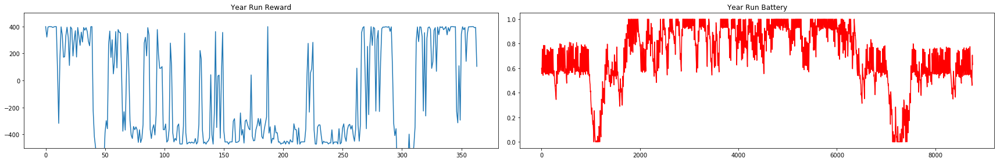


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -29.862778293307862


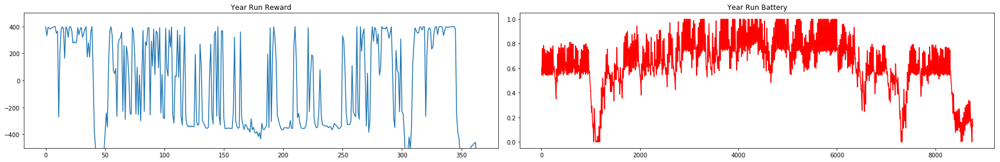


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -18.12671366956826


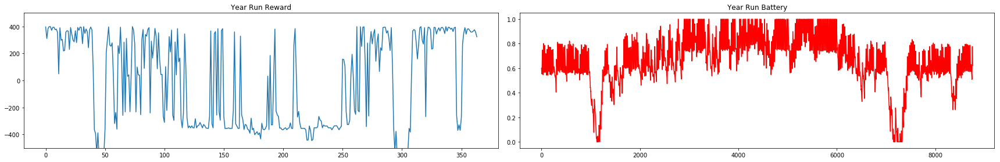


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -155.43260543669504


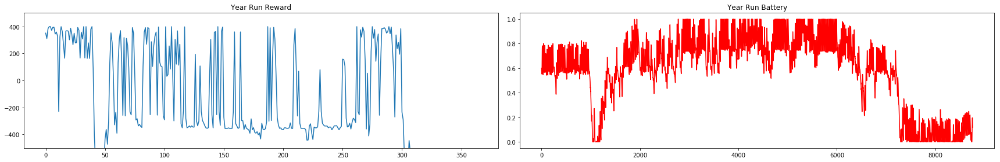


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year
Environment is RESET

Year run test
Environment is RESET
End of Year
Average Reward:  -199.7423648519789


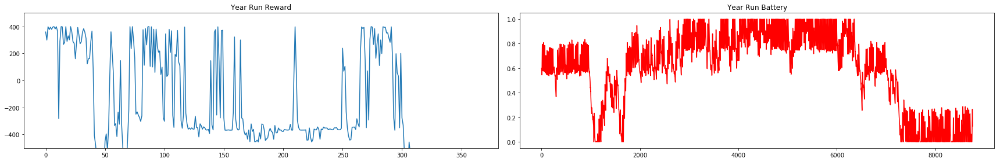

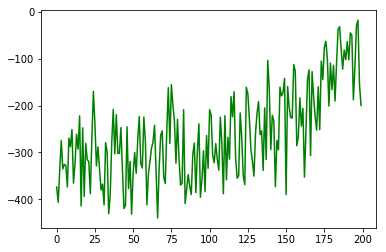

In [9]:
sarsa = SARSA()

NO_OF_ITERATIONS = 200
avg_reward_rec = np.empty(1)

for iteration in range(NO_OF_ITERATIONS):
    if (50< iteration <= 150):
        LR = 0.1                   # learning rate
        EPSILON = 0.7              # greedy policy
    elif (150<iteration<=NO_OF_ITERATIONS):
        LR = 0.02
        EPSILON = 0.9
    else:
        LR = 0.2
        EPSILON = 0.7
    
    ############################################################################################
    #LEARN WITHOUT RESETTING BATTERY EVERYDAY AND BY SHUFFLING DAYS
    print('\nCollecting experience... Iteration:', iteration)
    print('Learning Rate = ', LR)
    print('EPSILON = ', EPSILON)
    
    eno = ENO(2010, shuffle=True)
    ps, r, done, info = eno.reset()
    
    while True:
        s = sarsa.discretize(ps)
        a = sarsa.choose_action(s)
        ns, r, done, info = eno.step(a)

        #if battery gets full, reset it to optimal value
        if eno.batt >= eno.BMAX:
            eno.batt = eno.BOPT
        
        if eno.hr == 0: #flag to let the sarsa algorithm know that the reward has been obtained
            terminal = True
#             eno.batt = eno.BOPT
#             ns = eno.getstate()
        else:
            terminal = False
        
        s_ = sarsa.discretize(ns)
        a_ = sarsa.choose_action(s_)        
        transition = [s,a,r,s_,a_]
        
        sarsa.learn(transition,terminal)
        if done:
            print("End of Year")
            break

        ps = ns
    
    ############################################################################################
    #TEST WITHOUT SHUFFLING DAYS OR RESETTING BATTERY
    eno = ENO(2010, shuffle=False)
    eno.reset()
    print('\nYear run test')
    ps, r, done, info = eno.reset()
    year_test_record = np.empty(4)

    while True:
        s = sarsa.discretize(ps)
        a = sarsa.choose_greedy_action(s)

        year_test_record = np.vstack((year_test_record, [ps[0],ps[2],r, a])) #record battery, henergy, reward and action

        ns, r, done, info = eno.step(a)

            
#         if eno.hr == 0: #flag to let the sarsa algorithm know that the reward has been obtained
#             eno.batt = eno.BOPT
#             ns = eno.getstate()

        s_ = sarsa.discretize(ns)
        a_ = sarsa.choose_action(s_)        

        if done:
            print("End of Year")
            break

        ps = ns

    year_test_record = np.delete(year_test_record, 0, 0) #remove the first row which is garbage
    year_test_reward_rec = year_test_record[:,2]
    year_test_reward_rec = year_test_reward_rec[year_test_reward_rec != 0]
    print("Average Reward: ", np.mean(year_test_reward_rec))
    avg_reward_rec = np.append(avg_reward_rec, np.mean(year_test_reward_rec))


    ############################################################################################
    #PLOT
    fig = plt.figure(figsize=(24,4))
    ax1 = fig.add_subplot(121)
    ax1.plot(year_test_reward_rec)
    ax1.set_title("Year Run Reward")
    ax1.set_ylim([-500,500])

    ax2 = fig.add_subplot(122)
    ax2.plot(year_test_record[:,0],'r')
    ax2.set_title("Year Run Battery")
    # ax2.set_ylim([0,1])

    fig.tight_layout()
    plt.show()

#PLOT THE AVERAGE REWARD OVER THE ITERATIONS
avg_reward_rec = np.delete(avg_reward_rec, 0, 0) #remove the first row which is garbage
plt.plot(avg_reward_rec,'g')

In [10]:
np.save('dynamic_learning_with_shuffle_and_no_battery_reset.npy', sarsa.q) 